In [32]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [33]:
import os
from owi_data_2_pandas.io import API
import datetime
from pytz import utc
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

# Import vub Meetenet Vlaamse Banken API functions
from vubmvbc.config import Credentials
from vubmvbc.client import Base
from vubmvbc.objects import Catalog, Data
import vubmvbc.data_getter as dg

from oma_tracking.oma_clustering import ModeClusterer  #pip install hdbscan --no-build-isolation --no-binary :all
from oma_tracking.data.make_dataset import DatasetGetter, get_scada_subset, get_weather_subset
from oma_tracking.data.utils import get_rated_data, get_parked_data, read_simulations_csv_files
from oma_tracking.scouring.scouring import aggregate_time_series

First run the mode_tracking notebook for this location!

In [ ]:
start =  datetime.datetime(2022,11,1,tzinfo=utc)
stop  = datetime.datetime(2023,5,4,tzinfo=utc)
location = 'nw2d01'
name_location = 'NW2_D01'

home_folder = "../../../"
# Data Paths
data_file_name = '_'.join([location, start.strftime("%Y%m%d"), stop.strftime("%Y%m%d")])
data_path = home_folder + "data/nw2/raw/" + data_file_name + ".parquet"
mvbc_path = home_folder + "data/nw2/mvbc_data.parquet"
tracked_frequencies_path = home_folder + "data/nw2/tracked_modes/harmonics_removed/" + location + ".parquet"
simulations_data_path = home_folder + "data/nw2/simulations/" + location + "/"
simulations_data_path


# Get all the data
data = pd.read_parquet(data_path)
mvbc_data = pd.read_parquet(mvbc_path)
tracked_frequencies = pd.read_parquet(tracked_frequencies_path)
simulation_data = read_simulations_csv_files(simulations_data_path + "eigen_frequencies/")
simulation_shifts = read_simulations_csv_files(simulations_data_path + "mean_shifts/")
simulation_errors = pd.read_csv(simulations_data_path + "errors/Errors_No_scour.csv", index_col=0)

In [ ]:
# Data Transformation
mode_simulation_data = {
    'SS1': pd.DataFrame(),
    'FA1': pd.DataFrame(),
    'SS2': pd.DataFrame(),
    'FA2': pd.DataFrame(),
}
for key in simulation_data.keys():
    if 'Eigen_' in key:
        simulation_data[key].rename(
            columns={
                '1st SS': 'SS1',
                '1st FA': 'FA1',
                '2nd SS': 'SS2',
                '2nd FA': 'FA2',
            }, inplace=True
        )
        for mode in ['SS1', 'FA1', 'SS2', 'FA2']:
            mode_simulation_data[mode][key] = simulation_data[key][mode]

# order the columns
cols = list(simulation_data.keys())
ordered_cols = [cols[0]] + cols[9:11] + cols[1:9] + [cols[11]] + cols[20:22] + cols[12:20]
for mode in ['SS1', 'FA1', 'SS2', 'FA2']:
    mode_simulation_data[mode] = mode_simulation_data[mode][ordered_cols]
    mode_simulation_data[mode].to_csv(simulations_data_path + "mode_frequencies/" + mode + ".csv")

tracked_modes = \
    tracked_frequencies.rename(
        columns = {
            'FA1': '1st FA',
            'FA2': '2nd FA',
            'SS1': '1st SS',
            'SS2': '2nd SS',
        }
    )

In [ ]:
import mlflow
models = {}
for mode in tracked_frequencies.columns:
    model_name = 'mpe_' + name_location + '_' + mode + '_normalization'
    stage = 'Staging'
    try:
        models[mode] = \
            mlflow.pyfunc.load_model(
                model_uri=f"models:/{model_name}/{stage}")
    except:
        print('no ' + stage + ' model ' + model_name)

2023/05/15 14:26:39 WARNING mlflow.store.db.utils: SQLAlchemy engine could not be created. The following exception is caught.
(psycopg2.OperationalError) connection to server at "10.0.0.139", port 5432 failed: Connection timed out (0x0000274C/10060)
	Is the server running on that host and accepting TCP/IP connections?

(Background on this error at: https://sqlalche.me/e/14/e3q8)
Operation will be retried in 0.1 seconds


In [ ]:
weather_inputs = get_weather_subset(mvbc_data)
scada_inputs = get_scada_subset(data)

inputs = \
    pd.concat(
        [
            weather_inputs,
            scada_inputs
        ],
        axis=1
    )

prediction_params = \
    tracked_frequencies 

In [ ]:
predictions = pd.DataFrame(index = inputs.dropna().index)
for mode in models.keys():
    predictions[mode] = models[mode].predict(inputs.dropna())
residuals = prediction_params - predictions
normalized = residuals + tracked_frequencies.mean()

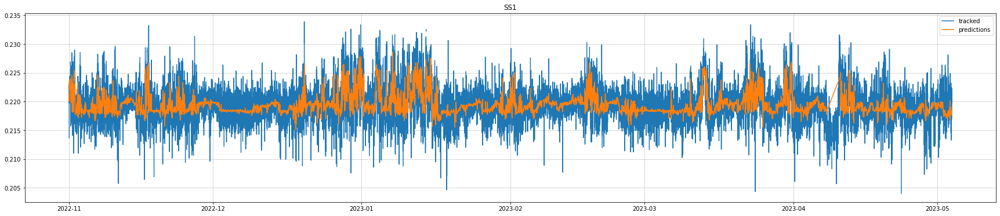

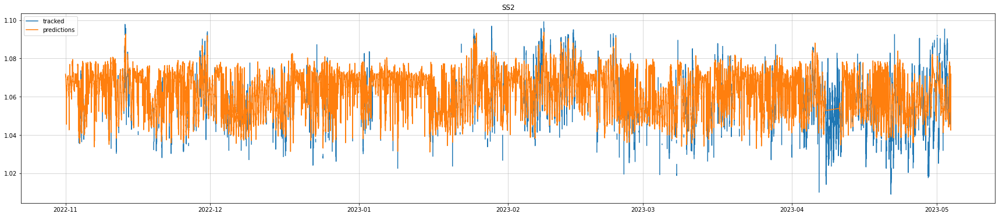

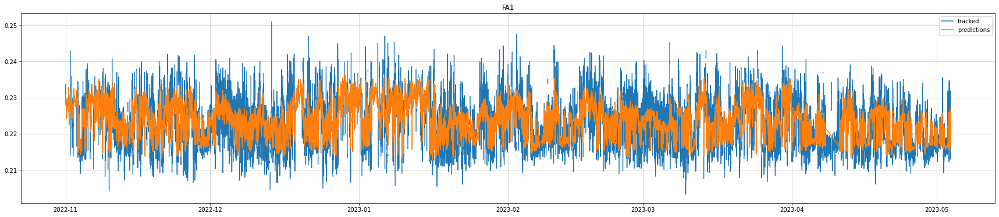

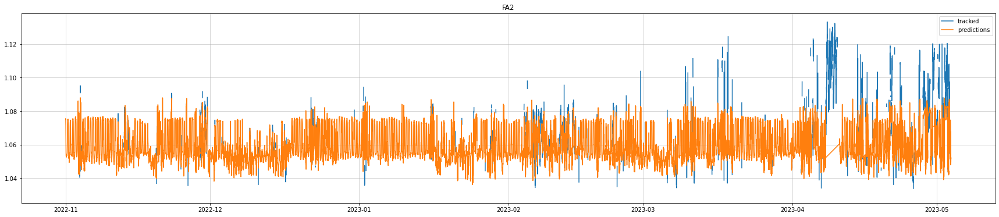

In [ ]:
for mode in tracked_frequencies.columns:
    plt.figure(figsize=(30,6))
    plt.grid('--', linewidth=0.5)
    plt.title(mode)
    plt.plot(tracked_frequencies[mode], label = 'tracked')
    plt.plot(predictions[mode], label = 'predictions')
    plt.legend()
    plt.show()

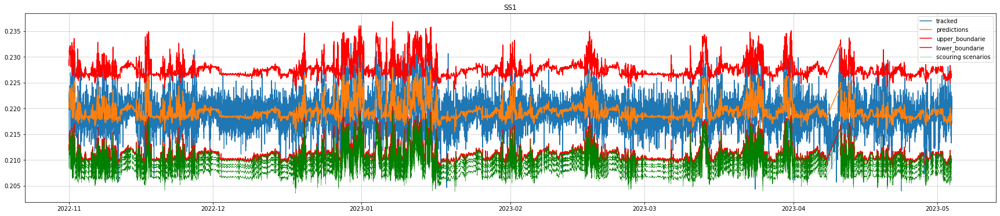

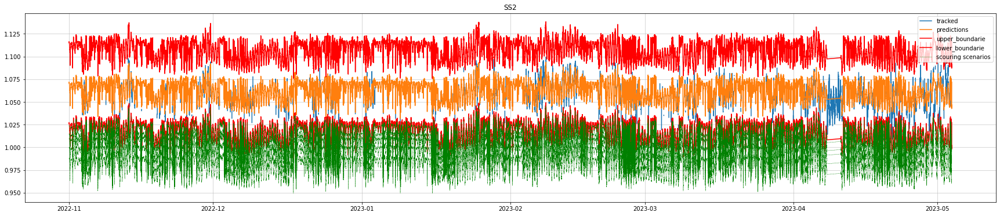

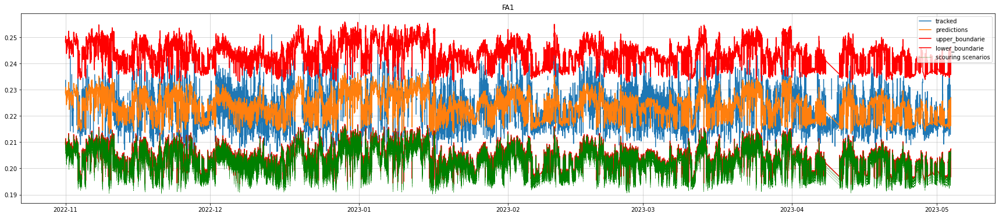

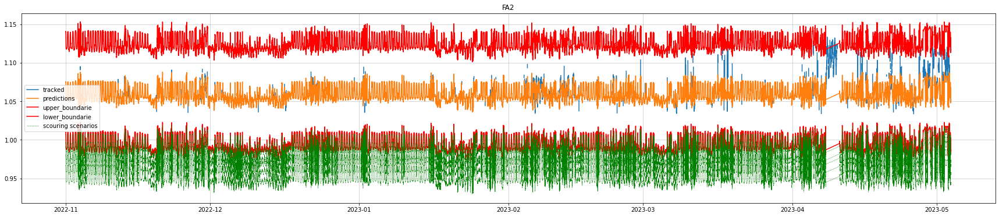

In [ ]:
for mode in tracked_frequencies.columns:
    three_sigma = 3*tracked_frequencies[mode].std()
    upper_boundarie = predictions[mode] + three_sigma
    lower_boundarie = predictions[mode] - three_sigma
    plt.figure(figsize=(30,6))
    plt.grid('--', linewidth=0.5)
    plt.title(mode)
    plt.plot(tracked_frequencies[mode], label = 'tracked')
    plt.plot(predictions[mode], label = 'predictions')
    plt.plot(upper_boundarie, label = 'upper_boundarie', color = 'red')
    plt.plot(lower_boundarie, label = 'lower_boundarie', color = 'red')
    
    
    label = 'scouring scenarios'
    for value in simulation_shifts['parked_scour'][mode].values[:5]:
        plt.plot(lower_boundarie - lower_boundarie*value/100, color='green', linestyle='--', linewidth=0.5, label = label)
        label =None
    plt.legend()
    plt.show()

In [ ]:
residuals[mode].fillna(method='ffill').rolling(1).mean().std()

0.00897440220166674

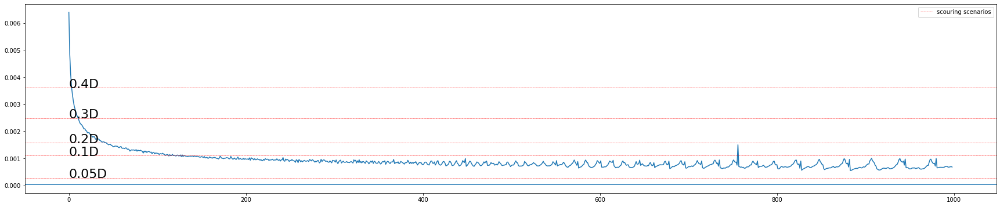

In [ ]:
mode = 'SS1'
font_size = 22
stds = []

for i in range(1,1000):
    std = 3*residuals[mode].fillna(method='ffill').resample(f'{10*i}T').mean().std()
    stds.append(std)

plt.figure(figsize=(30,6))
plt.plot(stds)
plt.axhline(residuals[mode].mean())
i = 0
label = 'scouring scenarios'
for value in simulation_shifts['parked_scour'][mode].values[:5]:
    plt.axhline(normalized[mode].mean()*value/100, color='red', linestyle='--', linewidth=0.5, label = label)
    plt.text(0, normalized[mode].mean()*value/100, simulation_shifts['parked_scour'].index[i], fontsize=font_size)
    i += 1
    label =None

plt.legend()
plt.show()

In [ ]:
import numpy as np
from scipy import stats


confidence  = 0.99
interval = stats.t.interval(confidence, len(data) - 1, loc=0, scale=std/np.sqrt(len(data)))
interval

z = stats.norm.ppf((1 + confidence) / 2)
z

2.5758293035489004

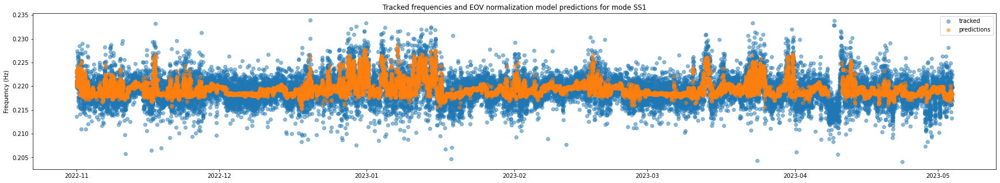

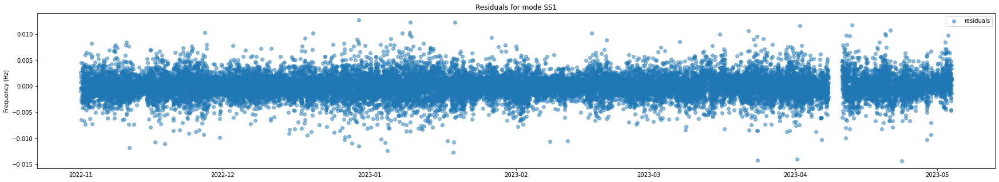

C:\Users\Max\AppData\Local\Temp\ipykernel_18504\3801775468.py:33: FutureWarning: Indexing a timezone-aware DatetimeIndex with a timezone-naive datetime is deprecated and will raise KeyError in a future version. Use a timezone-aware object instead.
  var_training = residuals[mode].loc[:end_training].var(ddof=1)
C:\Users\Max\AppData\Local\Temp\ipykernel_18504\3801775468.py:38: FutureWarning: Indexing a timezone-aware DatetimeIndex with a timezone-naive datetime is deprecated and will raise KeyError in a future version. Use a timezone-aware object instead.
  mean = residuals[mode].loc[end_training:].iloc[0:i].mean() # mean average
C:\Users\Max\AppData\Local\Temp\ipykernel_18504\3801775468.py:42: FutureWarning: Indexing a timezone-aware DatetimeIndex with a timezone-naive datetime is deprecated and will raise KeyError in a future version. Use a timezone-aware object instead.
  means2.append(residuals[mode].loc[start1:].iloc[0:i].mean())
C:\Users\Max\AppData\Local\Temp\ipykernel_18504\38017

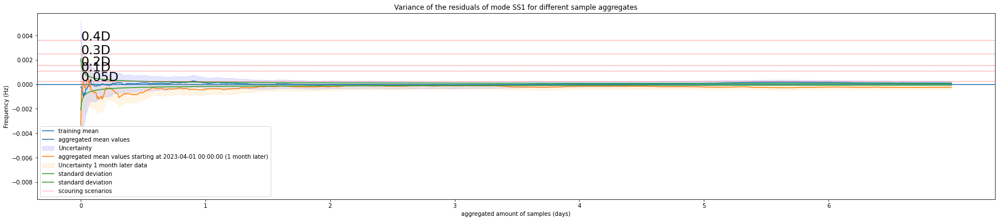

In [ ]:
import numpy as np 
end_training = datetime.datetime(2023, 3, 1)
end_test = datetime.datetime(2023, 5, 1)
mode = 'SS1'


plt.figure(figsize=(30,5))
plt.scatter(tracked_frequencies[mode].index, tracked_frequencies[mode], label = 'tracked', alpha = 0.5)
plt.scatter(predictions[mode].index, predictions[mode], label = 'predictions', alpha=0.5)
plt.legend()
plt.ylabel('Frequency (Hz)')
plt.title('Tracked frequencies and EOV normalization model predictions for mode ' + mode)
plt.show()

plt.figure(figsize=(30,5))
plt.scatter(residuals[mode].index, residuals[mode], label = 'residuals', alpha=0.5)
plt.legend()
plt.ylabel('Frequency (Hz)')
plt.title('Residuals for mode ' + mode)
plt.show()

stds = []
means = []
uncertainty_min = []
uncertainty_max = []
means2 = []
uncertainty_min2 = []
uncertainty_max2 = []

confidence = 0.99
z = stats.norm.ppf((1 + confidence) / 2)

start1 = datetime.datetime(2023,4,1)
var_training = residuals[mode].loc[:end_training].var(ddof=1)
for i in range(1,144*7):
    std = np.sqrt(var_training/i) # std average   
    stds.append(std)

    mean = residuals[mode].loc[end_training:].iloc[0:i].mean() # mean average
    uncertainty_min.append(mean-z*std)
    uncertainty_max.append(mean+z*std)
    means.append(mean)
    means2.append(residuals[mode].loc[start1:].iloc[0:i].mean())
    uncertainty_min2.append(residuals[mode].loc[start1:].iloc[0:i].mean()-z*std)
    uncertainty_max2.append(residuals[mode].loc[start1:].iloc[0:i].mean()+z*std)


plt.figure(figsize=(30,6))

plt.axhline(residuals[mode].loc[:end_training].mean(), label = 'training mean')
plt.plot(means, label='aggregated mean values')
plt.fill_between(range(len(means)), uncertainty_min, uncertainty_max, color='blue', alpha=0.1, label='Uncertainty')
plt.plot(means2, label='aggregated mean values starting at ' + str(start1) + ' (1 month later)')
plt.fill_between(range(len(means2)), uncertainty_min2, uncertainty_max2, color='orange', alpha=0.1, label='Uncertainty 1 month later data')

plt.plot(stds, label='standard deviation', color = '#2ca02c')
plt.plot([-x for x in stds], label='standard deviation', color = '#2ca02c')

i = 0
label = 'scouring scenarios'
for value in simulation_shifts['parked_scour'][mode].values[:5]:
    plt.axhline(normalized[mode].mean()*value/100, color='red', linestyle='--', linewidth=0.5, label = label)
    plt.text(0, normalized[mode].mean()*value/100, simulation_shifts['parked_scour'].index[i], fontsize=font_size)
    i += 1
    label =None

# Customizing the x-axis ticks
tick_interval = 144  # Interval between ticks
tick_locations = np.arange(0, len(stds), tick_interval)  # Generate tick locations

# Generate tick labels based on tick locations
tick_labels = [str(i // tick_interval) for i in tick_locations]

plt.xticks(tick_locations, tick_labels)  # Set the custom ticks and labels

plt.xlabel('aggregated amount of samples (days)')
plt.ylabel('Frequency (Hz)')
plt.legend()
plt.title('Variance of the residuals of mode ' + mode + ' for different sample aggregates')

plt.show()

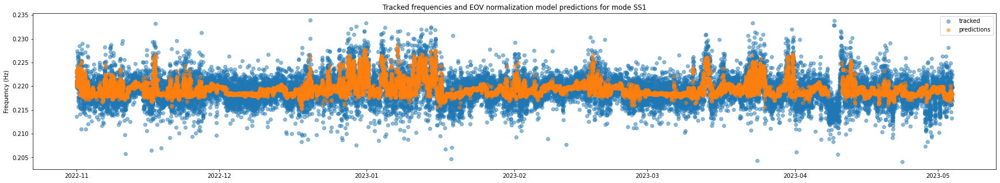

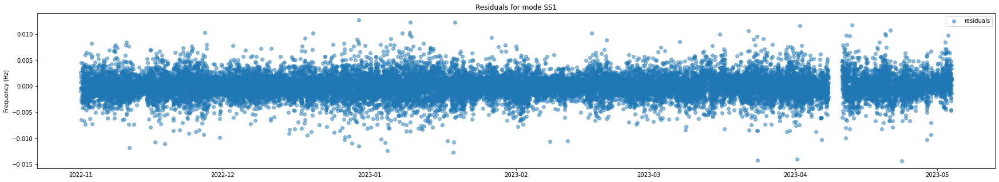

C:\Users\Max\AppData\Local\Temp\ipykernel_18504\3299836327.py:33: FutureWarning: Indexing a timezone-aware DatetimeIndex with a timezone-naive datetime is deprecated and will raise KeyError in a future version. Use a timezone-aware object instead.
  var_training = residuals[mode].loc[:end_training].var(ddof=1)
C:\Users\Max\AppData\Local\Temp\ipykernel_18504\3299836327.py:38: FutureWarning: Indexing a timezone-aware DatetimeIndex with a timezone-naive datetime is deprecated and will raise KeyError in a future version. Use a timezone-aware object instead.
  mean = residuals[mode].loc[end_training:].iloc[0:i].mean() # mean average
C:\Users\Max\AppData\Local\Temp\ipykernel_18504\3299836327.py:42: FutureWarning: Indexing a timezone-aware DatetimeIndex with a timezone-naive datetime is deprecated and will raise KeyError in a future version. Use a timezone-aware object instead.
  means2.append(residuals[mode].loc[start1:].iloc[0:i].mean())
C:\Users\Max\AppData\Local\Temp\ipykernel_18504\32998

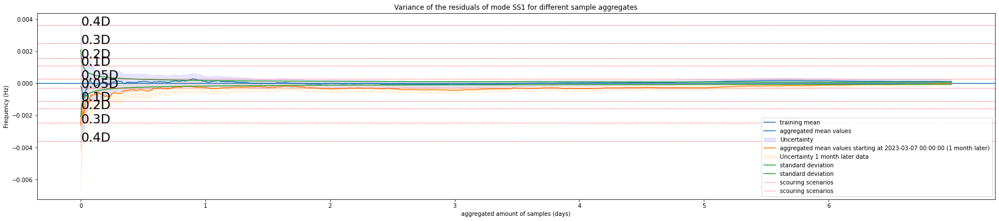

In [ ]:
import numpy as np 
end_training = datetime.datetime(2023, 3, 1)
end_test = datetime.datetime(2023, 5, 1)
mode = 'SS1'


plt.figure(figsize=(30,5))
plt.scatter(tracked_frequencies[mode].index, tracked_frequencies[mode], label = 'tracked', alpha = 0.5)
plt.scatter(predictions[mode].index, predictions[mode], label = 'predictions', alpha=0.5)
plt.legend()
plt.ylabel('Frequency (Hz)')
plt.title('Tracked frequencies and EOV normalization model predictions for mode ' + mode)
plt.show()

plt.figure(figsize=(30,5))
plt.scatter(residuals[mode].index, residuals[mode], label = 'residuals', alpha=0.5)
plt.legend()
plt.ylabel('Frequency (Hz)')
plt.title('Residuals for mode ' + mode)
plt.show()

confidence = 0.95
z = stats.norm.ppf((1 + confidence) / 2)
stds = []
means = []
uncertainty_min = []
uncertainty_max = []
means2 = []
uncertainty_min2 = []
uncertainty_max2 = []

start1 = datetime.datetime(2023,3,7)
var_training = residuals[mode].loc[:end_training].var(ddof=1)
for i in range(1,144*7):
    std = np.sqrt(var_training/i) # std average   
    stds.append(std)

    mean = residuals[mode].loc[end_training:].iloc[0:i].mean() # mean average
    uncertainty_min.append(mean-z*std)
    uncertainty_max.append(mean+z*std)
    means.append(mean)
    means2.append(residuals[mode].loc[start1:].iloc[0:i].mean())
    uncertainty_min2.append(residuals[mode].loc[start1:].iloc[0:i].mean()-z*std)
    uncertainty_max2.append(residuals[mode].loc[start1:].iloc[0:i].mean()+z*std)


plt.figure(figsize=(30,6))

plt.axhline(residuals[mode].loc[:end_training].mean(), label = 'training mean')
plt.plot(means, label='aggregated mean values')
plt.fill_between(range(len(means)), uncertainty_min, uncertainty_max, color='blue', alpha=0.1, label='Uncertainty')
plt.plot(means2, label='aggregated mean values starting at ' + str(start1) + ' (1 month later)')
plt.fill_between(range(len(means2)), uncertainty_min2, uncertainty_max2, color='orange', alpha=0.1, label='Uncertainty 1 month later data')

plt.plot(stds, label='standard deviation', color = '#2ca02c')
plt.plot([-x for x in stds], label='standard deviation', color = '#2ca02c')

i = 0
label = 'scouring scenarios'
for value in simulation_shifts['parked_scour'][mode].values[:5]:
    plt.axhline(normalized[mode].mean()*value/100, color='red', linestyle='--', linewidth=0.5, label = label)
    plt.text(0, normalized[mode].mean()*value/100, simulation_shifts['parked_scour'].index[i], fontsize=font_size)
    plt.axhline(-normalized[mode].mean()*value/100, color='red', linestyle='--', linewidth=0.5, label = label)
    plt.text(0, -normalized[mode].mean()*value/100, simulation_shifts['parked_scour'].index[i], fontsize=font_size)
    i += 1
    label =None

# Customizing the x-axis ticks
tick_interval = 144  # Interval between ticks
tick_locations = np.arange(0, len(stds), tick_interval)  # Generate tick locations

# Generate tick labels based on tick locations
tick_labels = [str(i // tick_interval) for i in tick_locations]

plt.xticks(tick_locations, tick_labels)  # Set the custom ticks and labels

plt.xlabel('aggregated amount of samples (days)')
plt.ylabel('Frequency (Hz)')
plt.legend()
plt.title('Variance of the residuals of mode ' + mode + ' for different sample aggregates')

plt.show()

In [ ]:
z

1.959963984540054

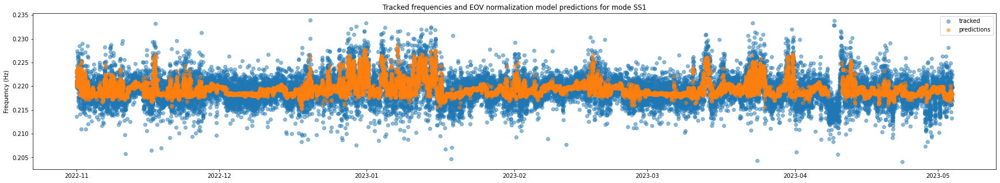

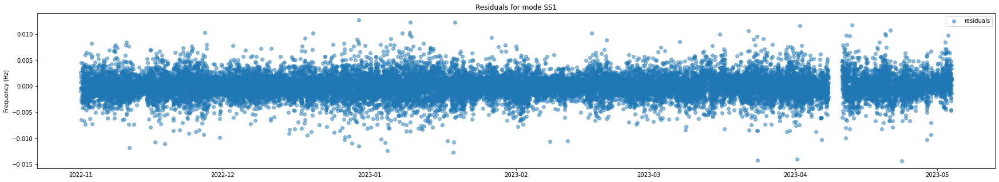

C:\Users\Max\AppData\Local\Temp\ipykernel_18504\793810665.py:35: FutureWarning: Indexing a timezone-aware DatetimeIndex with a timezone-naive datetime is deprecated and will raise KeyError in a future version. Use a timezone-aware object instead.
  var_training = residuals[mode].loc[:end_training].var(ddof=1)
C:\Users\Max\AppData\Local\Temp\ipykernel_18504\793810665.py:40: FutureWarning: Indexing a timezone-aware DatetimeIndex with a timezone-naive datetime is deprecated and will raise KeyError in a future version. Use a timezone-aware object instead.
  mean = residuals[mode].loc[end_training:].iloc[0:i].mean() # mean average
C:\Users\Max\AppData\Local\Temp\ipykernel_18504\793810665.py:44: FutureWarning: Indexing a timezone-aware DatetimeIndex with a timezone-naive datetime is deprecated and will raise KeyError in a future version. Use a timezone-aware object instead.
  means2.append(residuals[mode].loc[start1:].iloc[0:i].mean())
C:\Users\Max\AppData\Local\Temp\ipykernel_18504\79381066

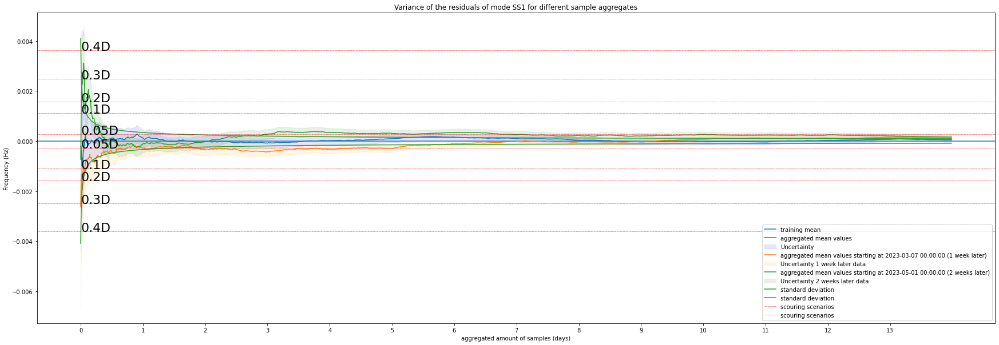

In [ ]:
import numpy as np 
end_training = datetime.datetime(2023, 3, 1)
end_test = datetime.datetime(2023, 5, 1)
mode = 'SS1'


plt.figure(figsize=(30,5))
plt.scatter(tracked_frequencies[mode].index, tracked_frequencies[mode], label = 'tracked', alpha = 0.5)
plt.scatter(predictions[mode].index, predictions[mode], label = 'predictions', alpha=0.5)
plt.legend()
plt.ylabel('Frequency (Hz)')
plt.title('Tracked frequencies and EOV normalization model predictions for mode ' + mode)
plt.show()

plt.figure(figsize=(30,5))
plt.scatter(residuals[mode].index, residuals[mode], label = 'residuals', alpha=0.5)
plt.legend()
plt.ylabel('Frequency (Hz)')
plt.title('Residuals for mode ' + mode)
plt.show()

stds = []
means = []
uncertainty_min = []
uncertainty_max = []
means2 = []
uncertainty_min2 = []
uncertainty_max2 = []
means3 = []
uncertainty_min3 = []
uncertainty_max3 = []

start1 = datetime.datetime(2023,3,7)
start2 = datetime.datetime(2023,3,14)
var_training = residuals[mode].loc[:end_training].var(ddof=1)
for i in range(1,144*14):
    std = z*np.sqrt(var_training/i) # std average   
    stds.append(std)

    mean = residuals[mode].loc[end_training:].iloc[0:i].mean() # mean average
    uncertainty_min.append(mean-std)
    uncertainty_max.append(mean+std)
    means.append(mean)
    means2.append(residuals[mode].loc[start1:].iloc[0:i].mean())
    uncertainty_min2.append(residuals[mode].loc[start1:].iloc[0:i].mean()-std)
    uncertainty_max2.append(residuals[mode].loc[start1:].iloc[0:i].mean()+std)
    means3.append(residuals[mode].loc[start2:].iloc[0:i].mean())
    uncertainty_min3.append(residuals[mode].loc[start2:].iloc[0:i].mean()-std)
    uncertainty_max3.append(residuals[mode].loc[start2:].iloc[0:i].mean()+std)


plt.figure(figsize=(30,10))

plt.axhline(residuals[mode].loc[:end_training].mean(), label = 'training mean')
plt.plot(means, label='aggregated mean values')
plt.fill_between(range(len(means)), uncertainty_min, uncertainty_max, color='blue', alpha=0.1, label='Uncertainty')
plt.plot(means2, label='aggregated mean values starting at ' + str(start1) + ' (1 week later)')
plt.fill_between(range(len(means2)), uncertainty_min2, uncertainty_max2, color='orange', alpha=0.1, label='Uncertainty 1 week later data')
plt.plot(means3, label='aggregated mean values starting at ' + str(end_test) + ' (2 weeks later)')
plt.fill_between(range(len(means3)), uncertainty_min3, uncertainty_max3, color='green', alpha=0.1, label='Uncertainty 2 weeks later data')

plt.plot(stds, label='standard deviation', color = '#2ca02c')
plt.plot([-x for x in stds], label='standard deviation', color = '#2ca02c')

i = 0
label = 'scouring scenarios'
for value in simulation_shifts['parked_scour'][mode].values[:5]:
    plt.axhline(normalized[mode].mean()*value/100, color='red', linestyle='--', linewidth=0.5, label = label)
    plt.text(0, normalized[mode].mean()*value/100, simulation_shifts['parked_scour'].index[i], fontsize=font_size)
    plt.axhline(-normalized[mode].mean()*value/100, color='red', linestyle='--', linewidth=0.5, label = label)
    plt.text(0, -normalized[mode].mean()*value/100, simulation_shifts['parked_scour'].index[i], fontsize=font_size)
    i += 1
    label =None

# Customizing the x-axis ticks
tick_interval = 144  # Interval between ticks
tick_locations = np.arange(0, len(stds), tick_interval)  # Generate tick locations

# Generate tick labels based on tick locations
tick_labels = [str(i // tick_interval) for i in tick_locations]

plt.xticks(tick_locations, tick_labels)  # Set the custom ticks and labels

plt.xlabel('aggregated amount of samples (days)')
plt.ylabel('Frequency (Hz)')
plt.legend()
plt.title('Variance of the residuals of mode ' + mode + ' for different sample aggregates')

plt.show()

C:\Users\Max\AppData\Local\Temp\ipykernel_18504\2093147979.py:3: FutureWarning: Indexing a timezone-aware DatetimeIndex with a timezone-naive datetime is deprecated and will raise KeyError in a future version. Use a timezone-aware object instead.
  plt.axhline(residuals[mode].loc[:end_training].mean(), label = 'training mean')


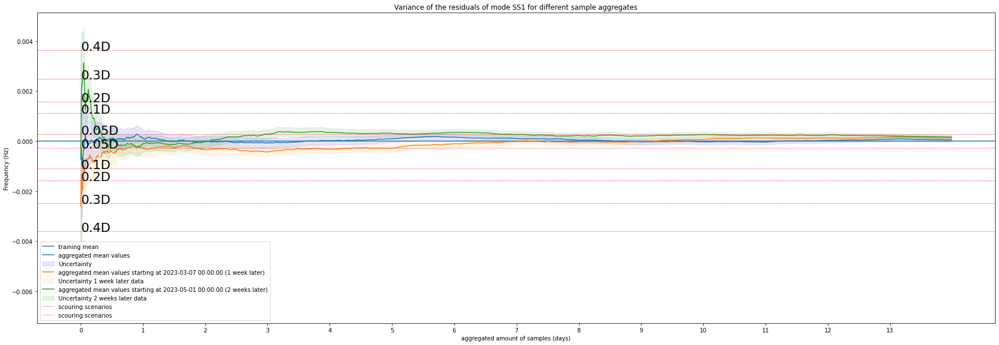

In [ ]:
plt.figure(figsize=(30,10))

plt.axhline(residuals[mode].loc[:end_training].mean(), label = 'training mean')
plt.plot(means, label='aggregated mean values')
plt.fill_between(range(len(means)), uncertainty_min, uncertainty_max, color='blue', alpha=0.1, label='Uncertainty')
plt.plot(means2, label='aggregated mean values starting at ' + str(start1) + ' (1 week later)')
plt.fill_between(range(len(means2)), uncertainty_min2, uncertainty_max2, color='orange', alpha=0.1, label='Uncertainty 1 week later data')
plt.plot(means3, label='aggregated mean values starting at ' + str(end_test) + ' (2 weeks later)')
plt.fill_between(range(len(means3)), uncertainty_min3, uncertainty_max3, color='green', alpha=0.1, label='Uncertainty 2 weeks later data')

i = 0
label = 'scouring scenarios'
for value in simulation_shifts['parked_scour'][mode].values[:5]:
    plt.axhline(normalized[mode].mean()*value/100, color='red', linestyle='--', linewidth=0.5, label = label)
    plt.text(0, normalized[mode].mean()*value/100, simulation_shifts['parked_scour'].index[i], fontsize=font_size)
    plt.axhline(-normalized[mode].mean()*value/100, color='red', linestyle='--', linewidth=0.5, label = label)
    plt.text(0, -normalized[mode].mean()*value/100, simulation_shifts['parked_scour'].index[i], fontsize=font_size)
    i += 1
    label =None

# Customizing the x-axis ticks
tick_interval = 144  # Interval between ticks
tick_locations = np.arange(0, len(stds), tick_interval)  # Generate tick locations

# Generate tick labels based on tick locations
tick_labels = [str(i // tick_interval) for i in tick_locations]

plt.xticks(tick_locations, tick_labels)  # Set the custom ticks and labels

plt.xlabel('aggregated amount of samples (days)')
plt.ylabel('Frequency (Hz)')
plt.legend()
plt.title('Variance of the residuals of mode ' + mode + ' for different sample aggregates')

plt.show()

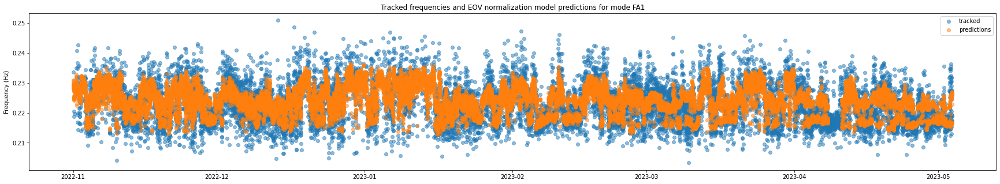

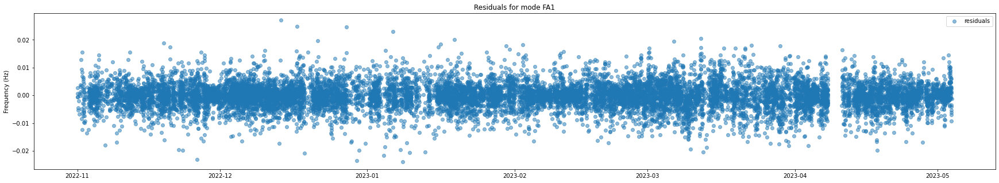

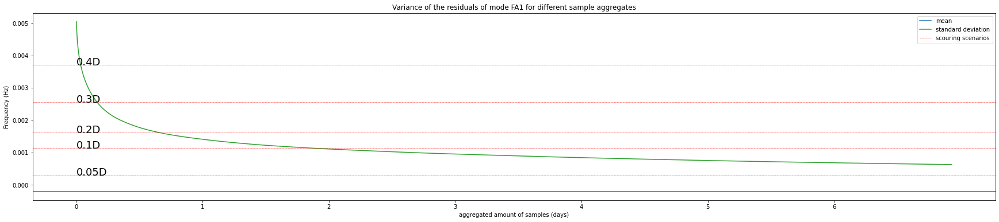

In [ ]:
import numpy as np 

mode = 'FA1'
stds = []

plt.figure(figsize=(30,5))
plt.scatter(tracked_frequencies[mode].index, tracked_frequencies[mode], label = 'tracked', alpha = 0.5)
plt.scatter(predictions[mode].index, predictions[mode], label = 'predictions', alpha=0.5)
plt.legend()
plt.ylabel('Frequency (Hz)')
plt.title('Tracked frequencies and EOV normalization model predictions for mode ' + mode)
plt.show()

plt.figure(figsize=(30,5))
plt.scatter(residuals[mode].index, residuals[mode], label = 'residuals', alpha=0.5)
plt.legend()
plt.ylabel('Frequency (Hz)')
plt.title('Residuals for mode ' + mode)
plt.show()

for i in range(1,1000):
    std = residuals[mode].fillna(method='ffill').rolling(i).mean().std()
    stds.append(std)

plt.figure(figsize=(30,6))

plt.axhline(residuals[mode].mean(), label = 'mean')
plt.plot(stds, label='standard deviation', color = '#2ca02c')
i = 0
label = 'scouring scenarios'
for value in simulation_shifts['parked_scour'][mode].values[:5]:
    plt.axhline(normalized[mode].mean()*value/100, color='red', linestyle='--', linewidth=0.5, label = label)
    plt.text(0, normalized[mode].mean()*value/100, simulation_shifts['parked_scour'].index[i], fontsize=font_size)
    i += 1
    label =None

# Customizing the x-axis ticks
tick_interval = 144  # Interval between ticks
tick_locations = np.arange(0, len(stds), tick_interval)  # Generate tick locations

# Generate tick labels based on tick locations
tick_labels = [str(i // tick_interval) for i in tick_locations]

plt.xticks(tick_locations, tick_labels)  # Set the custom ticks and labels

plt.xlabel('aggregated amount of samples (days)')
plt.ylabel('Frequency (Hz)')
plt.legend()
plt.title('Variance of the residuals of mode ' + mode + ' for different sample aggregates')

plt.show()

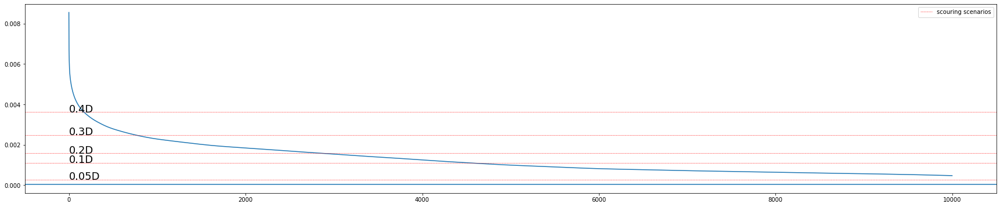

In [ ]:
mode = 'SS1'
stds = []

for i in range(1,10000):
    std = 3*tracked_frequencies[mode].fillna(method='ffill').rolling(i).mean().std()
    stds.append(std)

plt.figure(figsize=(30,6))
plt.plot(stds)
plt.axhline(residuals[mode].mean())
i = 0
label = 'scouring scenarios'
for value in simulation_shifts['parked_scour'][mode].values[:5]:
    plt.axhline(normalized[mode].mean()*value/100, color='red', linestyle='--', linewidth=0.5, label = label)
    plt.text(0, normalized[mode].mean()*value/100, simulation_shifts['parked_scour'].index[i], fontsize=font_size)
    i += 1
    label =None



plt.legend()
plt.show()

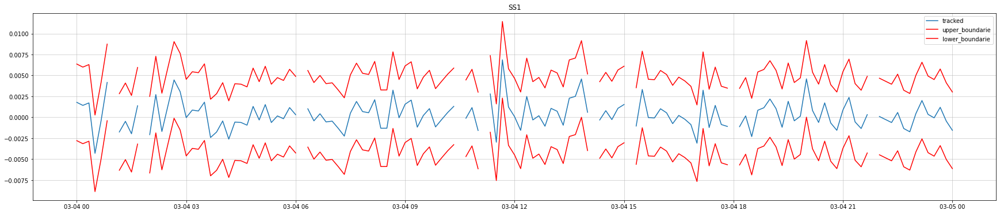

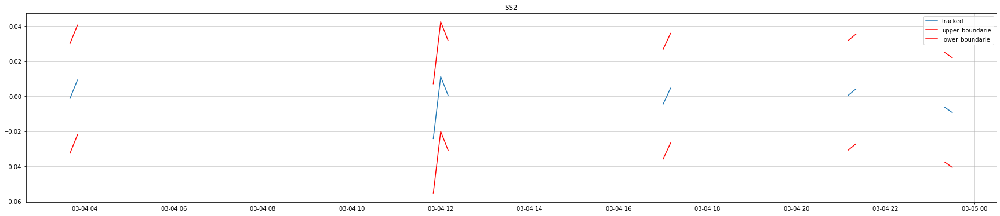

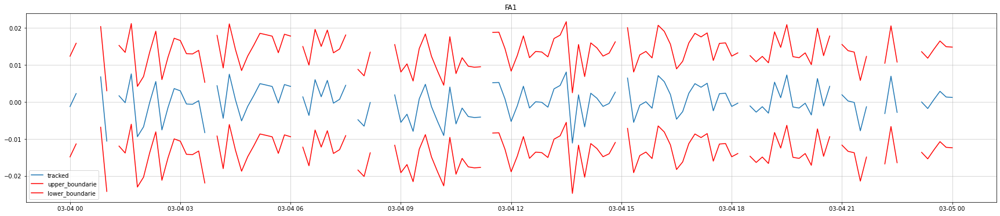

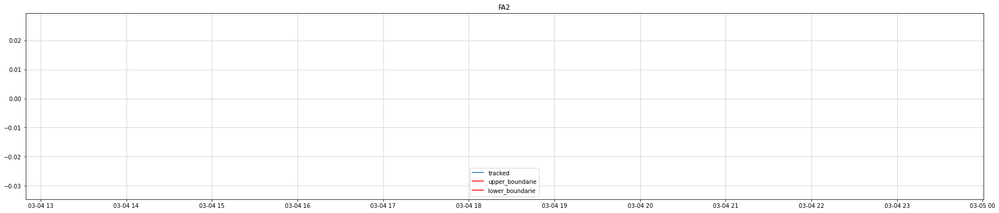

In [ ]:
start = datetime.datetime(2023,3,4,tzinfo=utc)
interval_days = 1
for mode in tracked_frequencies.columns:
    three_sigma = 3*predictions[mode].std()
    upper_boundarie = residuals[mode] + three_sigma
    lower_boundarie = residuals[mode] - three_sigma
    plt.figure(figsize=(30,6))
    plt.grid('--', linewidth=0.5)
    plt.title(mode)
    plt.plot(residuals[mode].loc[start:start+datetime.timedelta(days=interval_days)], label = 'tracked')
    plt.plot(upper_boundarie.loc[start:start+datetime.timedelta(days=interval_days)], label = 'upper_boundarie', color = 'red')
    plt.plot(lower_boundarie.loc[start:start+datetime.timedelta(days=interval_days)], label = 'lower_boundarie', color = 'red')
    label = 'scouring scenarios'
    #for value in simulation_shifts['parked_scour'][mode].values[:5]:
        #plt.plot((lower_boundarie - lower_boundarie*value/100).loc[start:start+datetime.timedelta(days=interval_days)], color='green', linestyle='--', linewidth=0.5, label = label)
        #label =None
    plt.legend()
    plt.show()


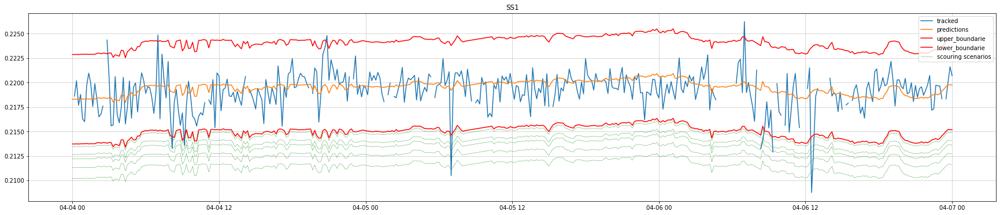

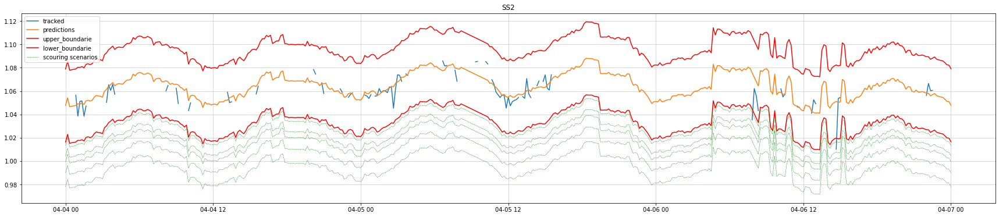

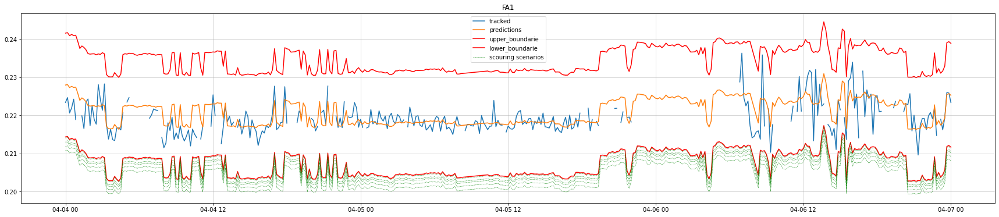

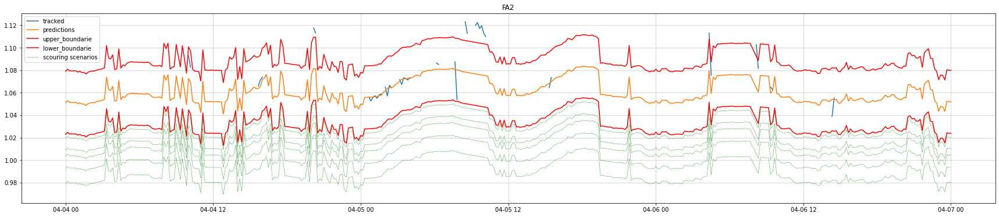

In [ ]:
start = datetime.datetime(2023,4,4,tzinfo=utc)
interval_days = 3
for mode in tracked_frequencies.columns:
    three_sigma = 3*predictions[mode].std()
    upper_boundarie = predictions[mode] + three_sigma
    lower_boundarie = predictions[mode] - three_sigma
    plt.figure(figsize=(30,6))
    plt.grid('--', linewidth=0.5)
    plt.title(mode)
    plt.plot(tracked_frequencies[mode].loc[start:start+datetime.timedelta(days=interval_days)], label = 'tracked')
    plt.plot(predictions[mode].loc[start:start+datetime.timedelta(days=interval_days)], label = 'predictions')
    plt.plot(upper_boundarie.loc[start:start+datetime.timedelta(days=interval_days)], label = 'upper_boundarie', color = 'red')
    plt.plot(lower_boundarie.loc[start:start+datetime.timedelta(days=interval_days)], label = 'lower_boundarie', color = 'red')
    label = 'scouring scenarios'
    for value in simulation_shifts['parked_scour'][mode].values[:5]:
        plt.plot((lower_boundarie - lower_boundarie*value/100).loc[start:start+datetime.timedelta(days=interval_days)], color='green', linestyle='--', linewidth=0.5, label = label)
        label =None
    plt.legend()
    plt.show()


In [ ]:
residuals[mode].isna().sum()

2856

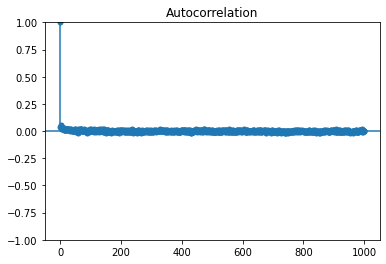

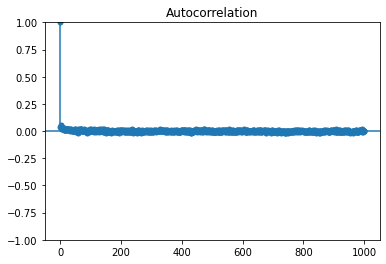

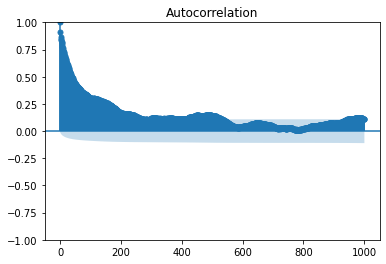

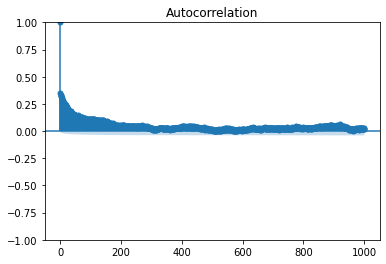

In [38]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt

mode = 'SS1'

# Compute autocorrelation using the acf() function
autocorr_values = sm.tsa.acf(residuals[mode].dropna(), nlags=1000)
# Plot the autocorrelation using plot_acf()
sm.graphics.tsa.plot_acf(residuals[mode].dropna(), lags=1000)

# Compute autocorrelation using the acf() function
autocorr_values = sm.tsa.acf(normalized[mode].dropna(), nlags=1000)
# Plot the autocorrelation using plot_acf()
sm.graphics.tsa.plot_acf(normalized[mode].dropna(), lags=1000)

# Compute autocorrelation using the acf() function
autocorr_values = sm.tsa.acf(predictions[mode].dropna(), nlags=1000)
# Plot the autocorrelation using plot_acf()
sm.graphics.tsa.plot_acf(predictions[mode].dropna(), lags=1000)

# Compute autocorrelation using the acf() function
autocorr_values = sm.tsa.acf(tracked_frequencies[mode].dropna(), nlags=1000)
# Plot the autocorrelation using plot_acf()
sm.graphics.tsa.plot_acf(tracked_frequencies[mode].dropna(), lags=1000)

# Show the plot
plt.show()

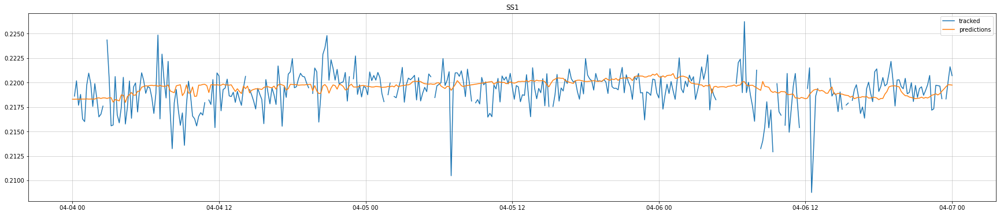

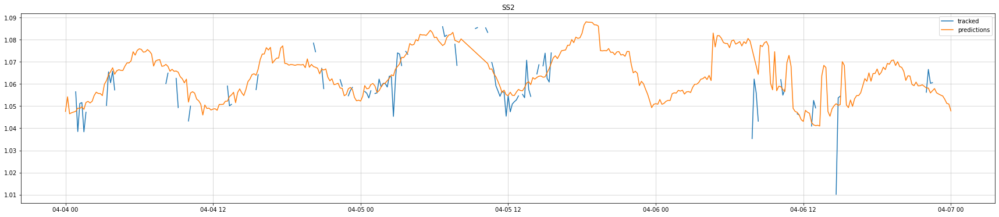

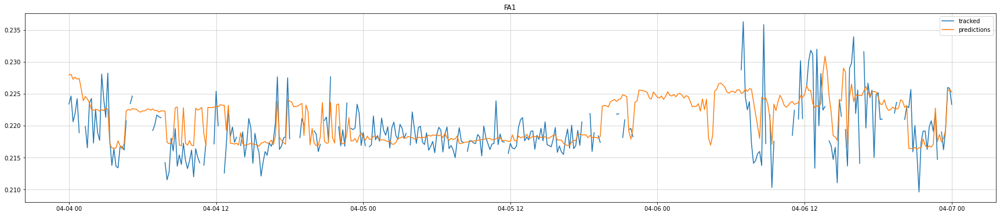

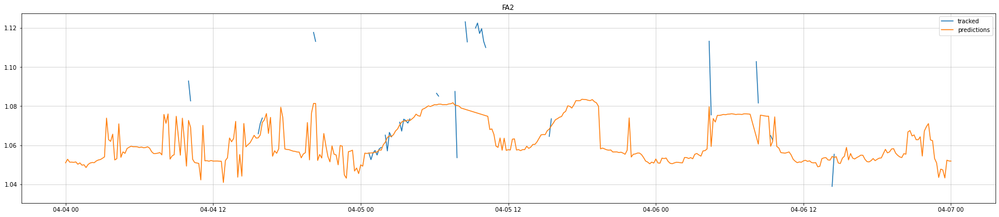

In [ ]:
start = datetime.datetime(2023,4,4,tzinfo=utc)
interval_days = 3
for mode in tracked_frequencies.columns:
    plt.figure(figsize=(30,6))
    plt.grid('--', linewidth=0.5)
    plt.title(mode)
    plt.plot(tracked_frequencies[mode].loc[start:start+datetime.timedelta(days=interval_days)], label = 'tracked')
    plt.plot(predictions[mode].loc[start:start+datetime.timedelta(days=interval_days)], label = 'predictions')
    plt.legend()
    plt.show()

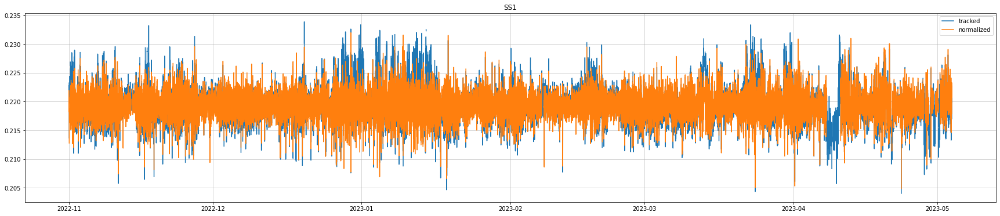

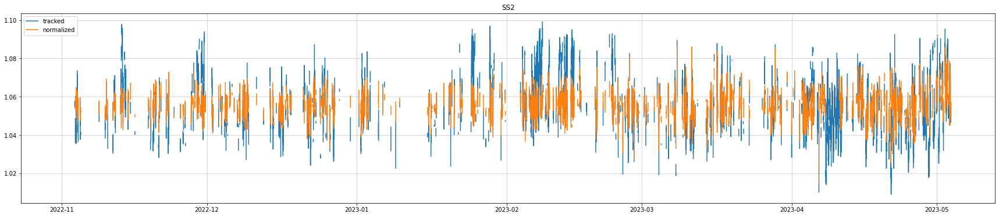

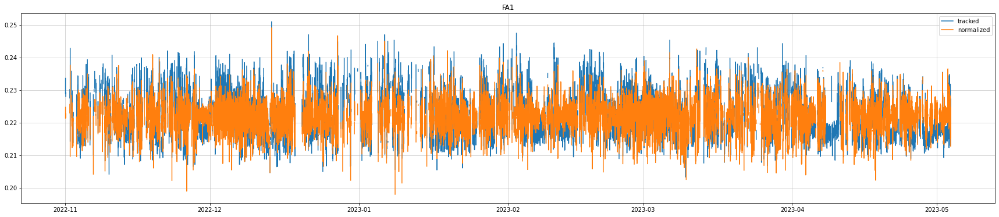

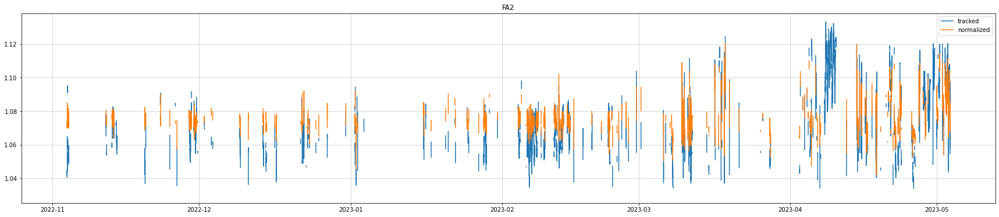

In [ ]:
for mode in tracked_frequencies.columns:
    plt.figure(figsize=(30,6))
    plt.grid('--', linewidth=0.5)
    plt.title(mode)
    plt.plot(tracked_frequencies[mode], label = 'tracked')
    plt.plot(normalized[mode], label = 'normalized')
    plt.legend()
    plt.show()

In [ ]:
simulation_shifts['parked_scour']

,SS1,FA1,SS2,FA2
0.05D,0.127630,0.129430,0.304177,0.349048
0.1D,0.505071,0.512128,1.182929,1.351545
0.2D,0.718151,0.728136,1.669114,1.902939
0.3D,1.132493,1.148117,2.613908,2.969391
0.4D,1.648498,1.671038,3.780256,4.276558
0.5D,2.191268,2.220945,4.989751,5.621893
0.6D,2.736351,2.773059,6.186122,6.942979
0.7D,3.202670,3.245277,7.191710,8.046403
0.8D,3.577377,3.624656,7.992412,8.920836


In [ ]:
timely_predictions - timely_predictions*value/100

,SS1,SS2,FA1,FA2
2022-12-31 00:00:00+00:00,0.218980,1.062773,0.224348,1.058039
2023-01-31 00:00:00+00:00,0.219125,1.059305,0.224226,1.055757
2023-02-28 00:00:00+00:00,0.219410,1.062572,0.224663,1.057551
2023-04-30 00:00:00+00:00,0.219149,1.060325,0.223979,1.057248


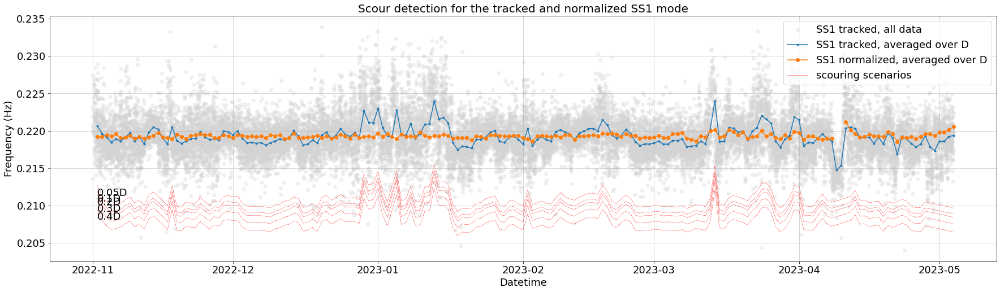

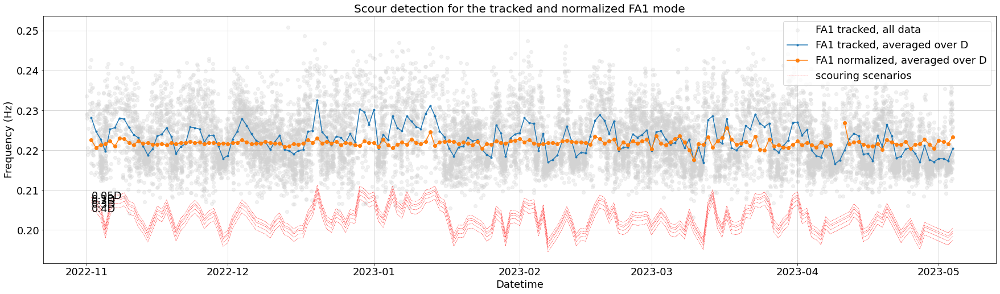

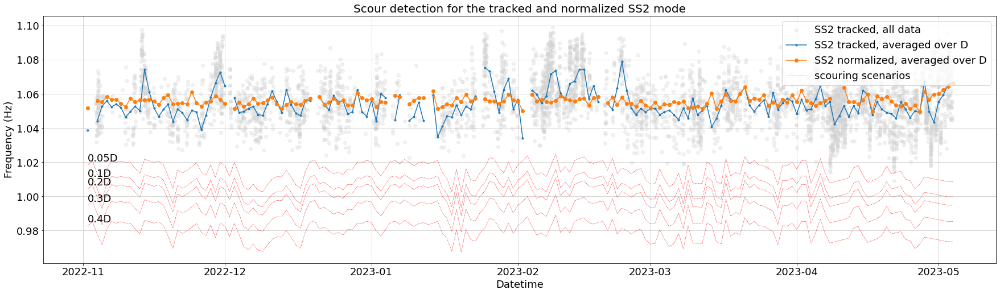

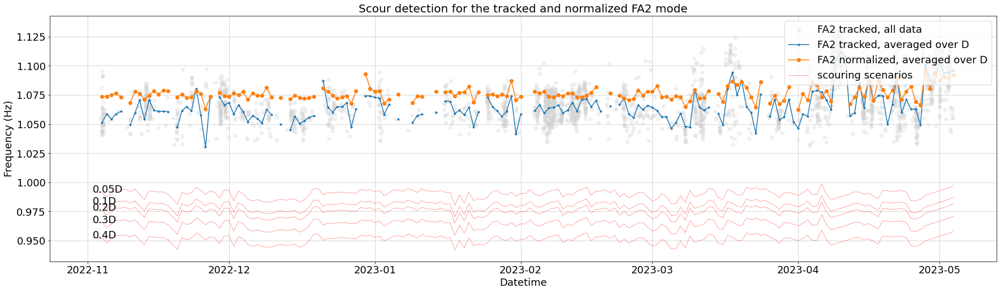

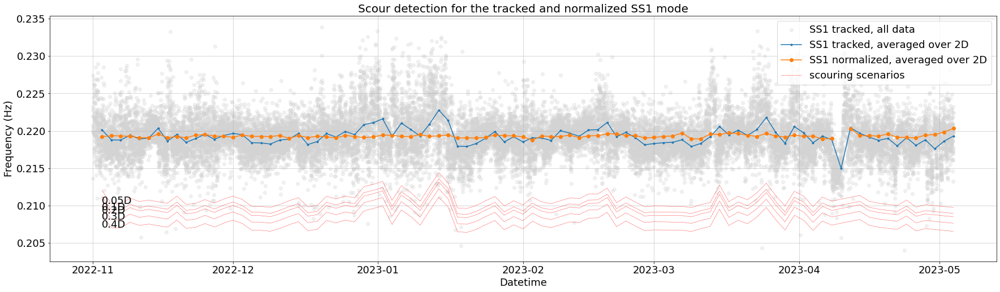

...

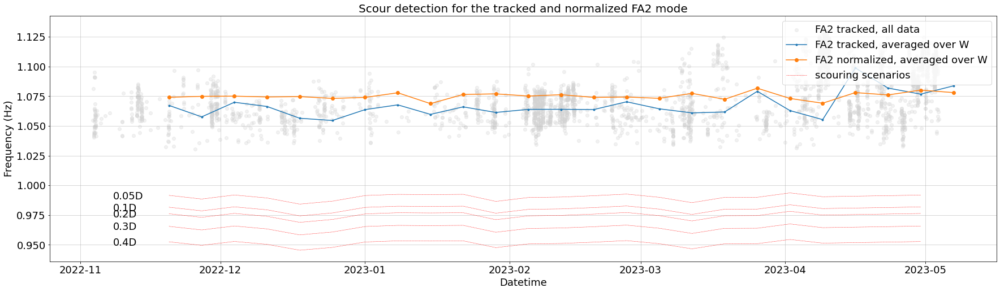

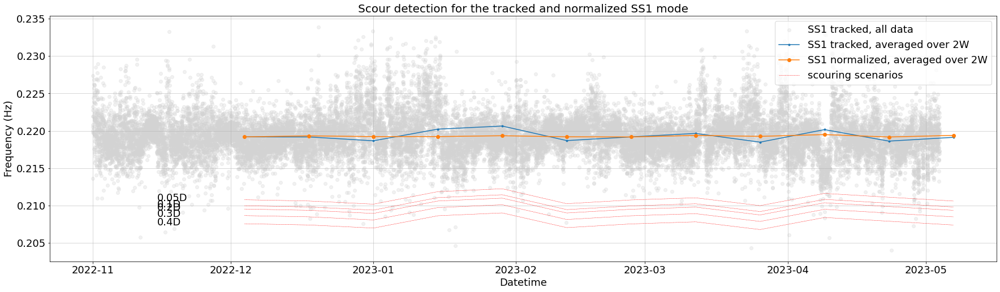

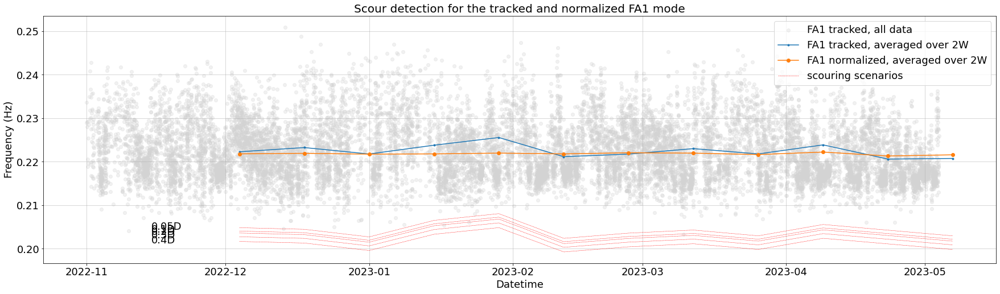

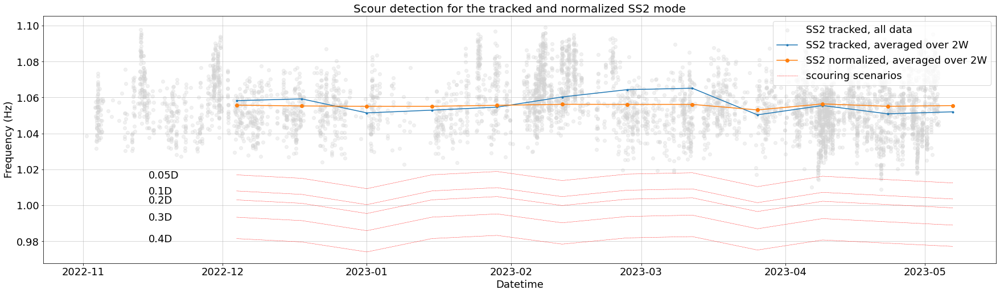

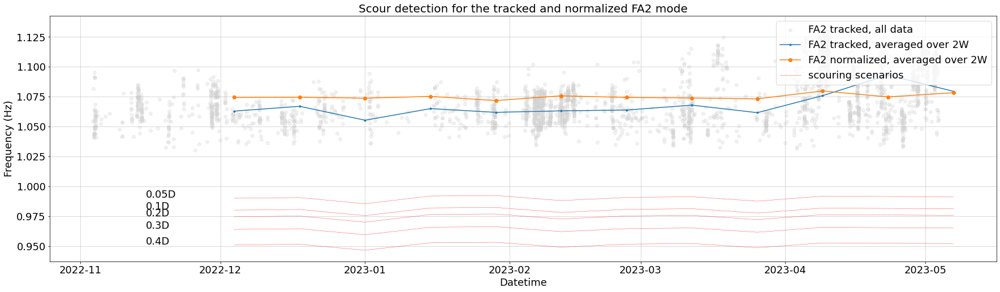

KeyError: Timestamp('2023-01-30 00:00:00+0000', tz='UTC')

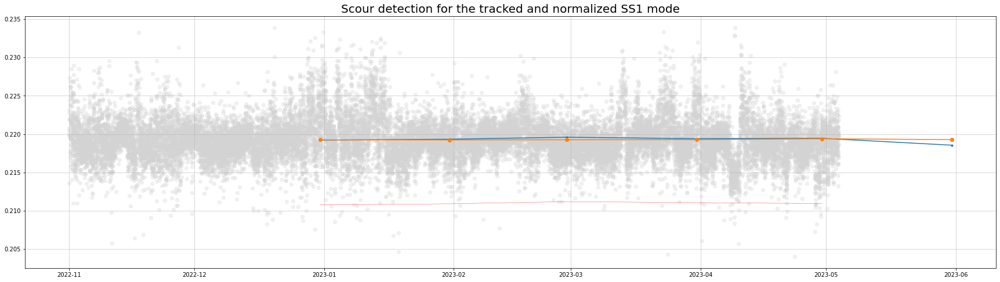

In [ ]:
import warnings
warnings.filterwarnings('ignore')
font_size = 18
markers = ['.', 'o', 'v', '^', '<', '>', '1', '2', '3', '4', '8', 's', 'p', '*', 'h', 'H', '+', 'x', 'D', 'd', '|', '_']
timespans = ['D', '2D', 'W', '2W', 'M']
timespan_days = [1, 2, 7, 14, 30]
for timespan in timespans:
    for mode in ['SS1', 'FA1', 'SS2', 'FA2']:
        plt.figure(figsize=(30,8))
        plt.grid('--', linewidth=0.5)
        plt.title('Scour detection for the tracked and normalized ' + mode + ' mode', fontsize = 20)
        m = 0
        i = 0
        
        timely_tracked_frequencies = aggregate_time_series(tracked_frequencies, timespan)
        timely_normalized_frequencies = aggregate_time_series(normalized, timespan)
        plt.scatter(tracked_frequencies[mode].index, tracked_frequencies[mode], color='lightgrey', label = mode + ' tracked, all data', alpha=0.3)
        plt.plot(timely_tracked_frequencies[mode], label = mode + ' tracked, averaged over ' + timespan, marker = markers[m])
        m += 1
        plt.plot(timely_normalized_frequencies[mode], label = mode + ' normalized, averaged over ' + timespan, marker = markers[m])
        label = 'scouring scenarios'
        three_sigma = 3*tracked_frequencies[mode].std()
        upper_boundarie = predictions[mode] + three_sigma
        lower_boundarie = predictions[mode] - three_sigma
        for value in simulation_shifts['parked_scour'][mode].values[:5]:
            lower_boundarie_aggr = aggregate_time_series(lower_boundarie, timespan)
            plt.plot(lower_boundarie_aggr - lower_boundarie_aggr*value/100, color='red', linestyle='--', linewidth=0.5, label = label)
            plt.text(
                normalized[mode].index[0] + datetime.timedelta(days=timespan_days[timespans.index(timespan)]),
                (lower_boundarie_aggr - lower_boundarie_aggr*value/100).loc[lower_boundarie_aggr.index[0]+datetime.timedelta(days=timespan_days[timespans.index(timespan)])],
                simulation_shifts['parked_scour'].index[i],
                fontsize=font_size)
            i += 1
            label =None
        plt.xticks(fontsize=font_size)
        plt.yticks(fontsize=font_size)
        plt.xlabel('Datetime', fontsize=font_size)
        plt.ylabel('Frequency (Hz)', fontsize=font_size)
        plt.legend(fontsize=font_size, loc='upper right')
        plt.show()

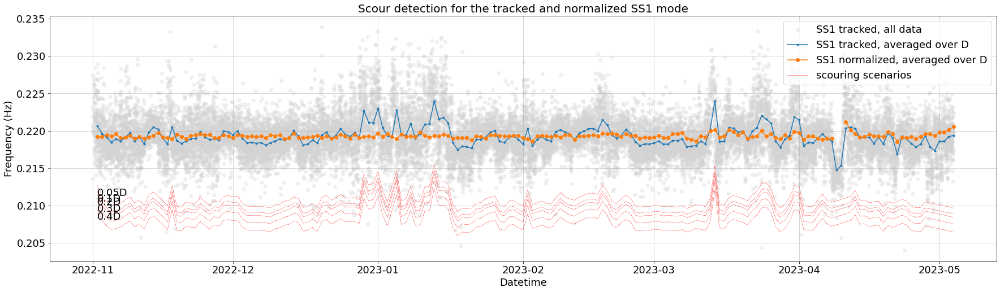

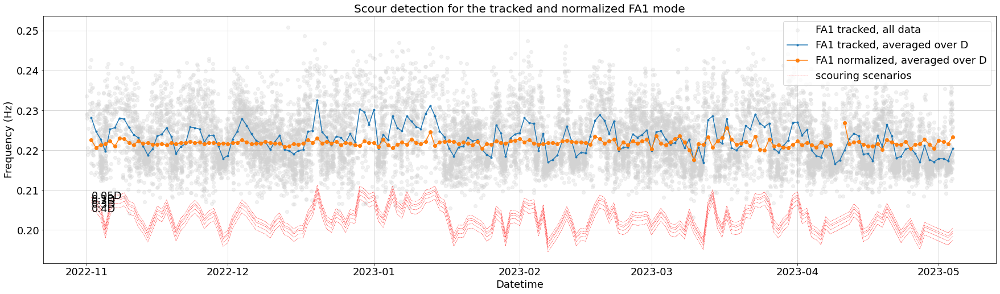

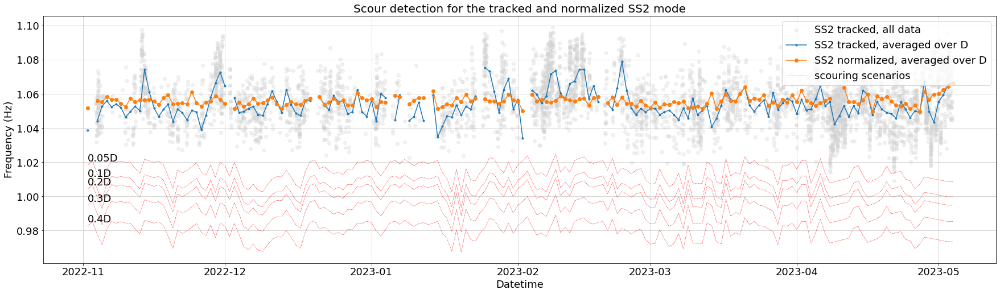

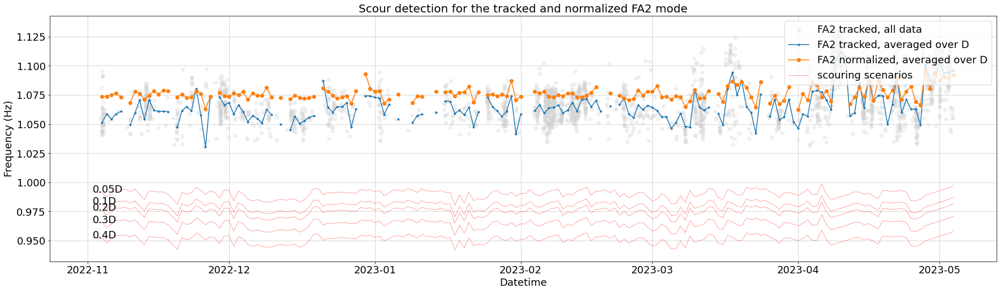

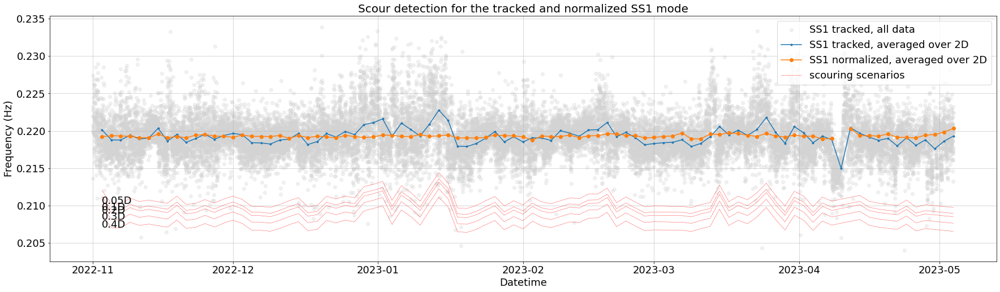

...

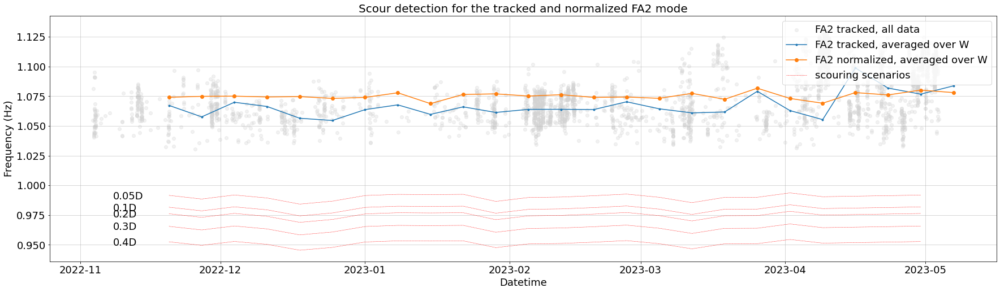

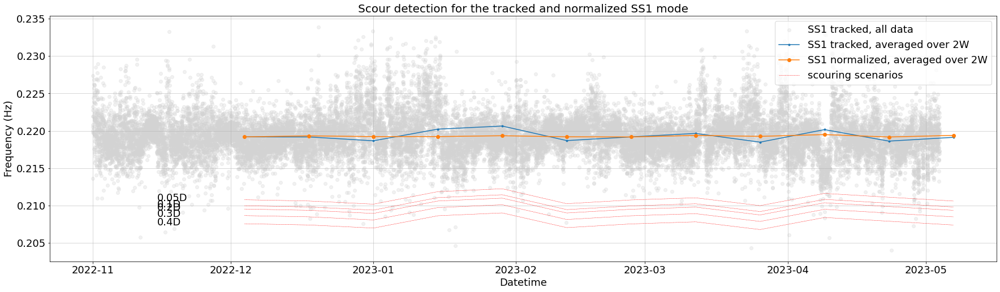

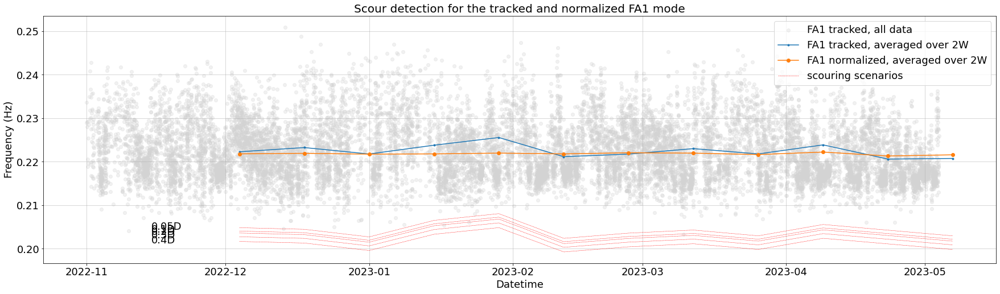

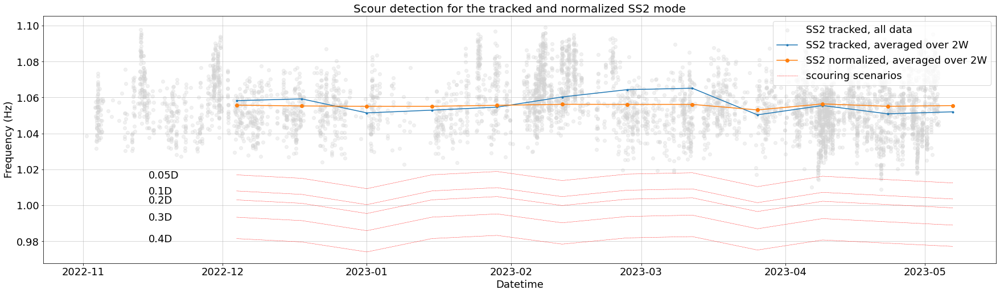

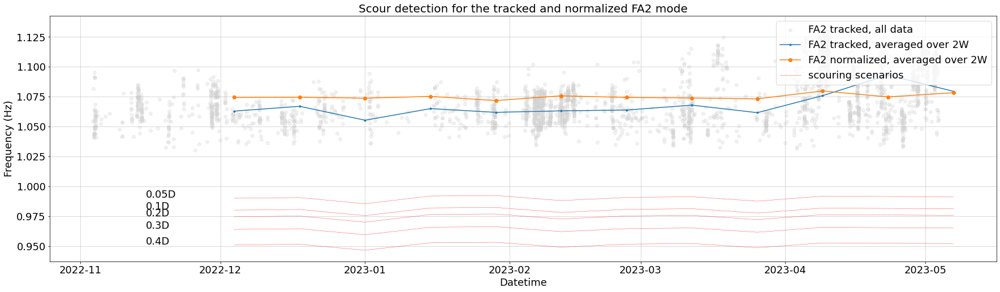

KeyError: Timestamp('2023-01-30 00:00:00+0000', tz='UTC')

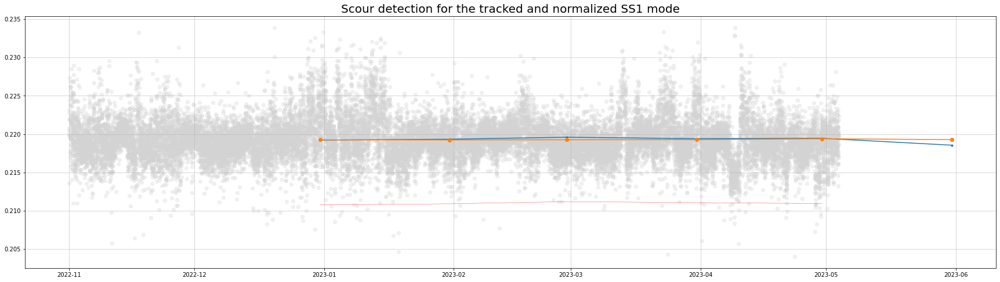

In [ ]:
import warnings
warnings.filterwarnings('ignore')
font_size = 18
markers = ['.', 'o', 'v', '^', '<', '>', '1', '2', '3', '4', '8', 's', 'p', '*', 'h', 'H', '+', 'x', 'D', 'd', '|', '_']
timespans = ['D', '2D', 'W', '2W', 'M']
timespan_days = [1, 2, 7, 14, 30]
for timespan in timespans:
    for mode in ['SS1', 'FA1', 'SS2', 'FA2']:
        plt.figure(figsize=(30,8))
        plt.grid('--', linewidth=0.5)
        plt.title('Scour detection for the tracked and normalized ' + mode + ' mode', fontsize = 20)
        m = 0
        i = 0
        
        timely_tracked_frequencies = aggregate_time_series(tracked_frequencies, timespan)
        timely_normalized_frequencies = aggregate_time_series(normalized, timespan)
        plt.scatter(tracked_frequencies[mode].index, tracked_frequencies[mode], color='lightgrey', label = mode + ' tracked, all data', alpha=0.3)
        plt.plot(timely_tracked_frequencies[mode], label = mode + ' tracked, averaged over ' + timespan, marker = markers[m])
        m += 1
        plt.plot(timely_normalized_frequencies[mode], label = mode + ' normalized, averaged over ' + timespan, marker = markers[m])
        label = 'scouring scenarios'
        three_sigma = 3*tracked_frequencies[mode].std()
        upper_boundarie = predictions[mode] + three_sigma
        lower_boundarie = predictions[mode] - three_sigma
        for value in simulation_shifts['parked_scour'][mode].values[:5]:
            lower_boundarie_aggr = aggregate_time_series(lower_boundarie, timespan)
            plt.plot(lower_boundarie_aggr - lower_boundarie_aggr*value/100, color='red', linestyle='--', linewidth=0.5, label = label)
            plt.text(
                normalized[mode].index[0] + datetime.timedelta(days=timespan_days[timespans.index(timespan)]),
                (lower_boundarie_aggr - lower_boundarie_aggr*value/100).loc[lower_boundarie_aggr.index[0]+datetime.timedelta(days=timespan_days[timespans.index(timespan)])],
                simulation_shifts['parked_scour'].index[i],
                fontsize=font_size)
            i += 1
            label =None
        plt.xticks(fontsize=font_size)
        plt.yticks(fontsize=font_size)
        plt.xlabel('Datetime', fontsize=font_size)
        plt.ylabel('Frequency (Hz)', fontsize=font_size)
        plt.legend(fontsize=font_size, loc='upper right')
        plt.show()

In [ ]:
timely_normalized_frequencies[mode] - std

2022-12-31 00:00:00+00:00    1.072710
2023-01-31 00:00:00+00:00    1.072670
2023-02-28 00:00:00+00:00    1.073602
2023-03-31 00:00:00+00:00    1.072745
2023-04-30 00:00:00+00:00    1.072603
2023-05-31 00:00:00+00:00    1.076562
Freq: M, Name: FA2, dtype: float64

In [ ]:
timely_normalized_frequencies[mode]

2022-12-31 00:00:00+00:00    1.074263
2023-01-31 00:00:00+00:00    1.074224
2023-02-28 00:00:00+00:00    1.075156
2023-03-31 00:00:00+00:00    1.074299
2023-04-30 00:00:00+00:00    1.074157
2023-05-31 00:00:00+00:00    1.078115
Freq: M, Name: FA2, dtype: float64

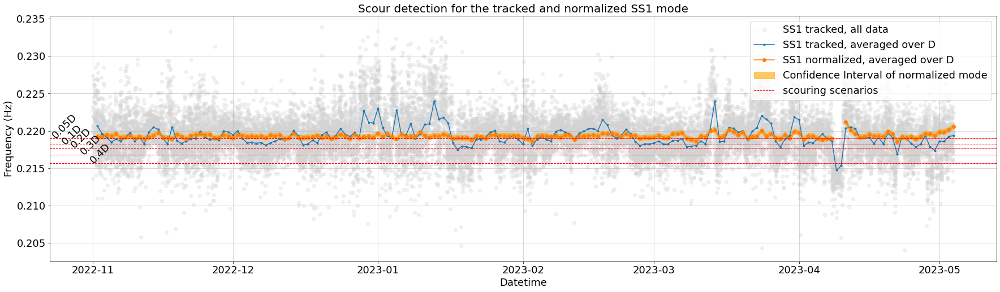

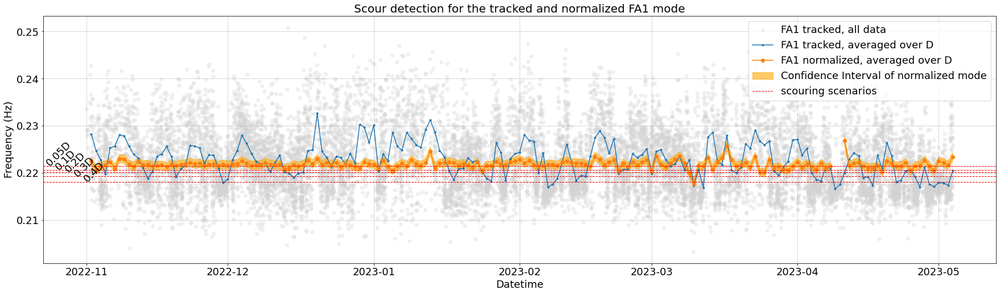

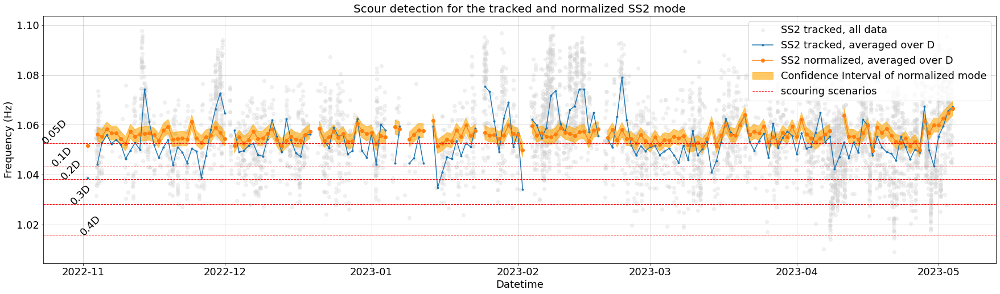

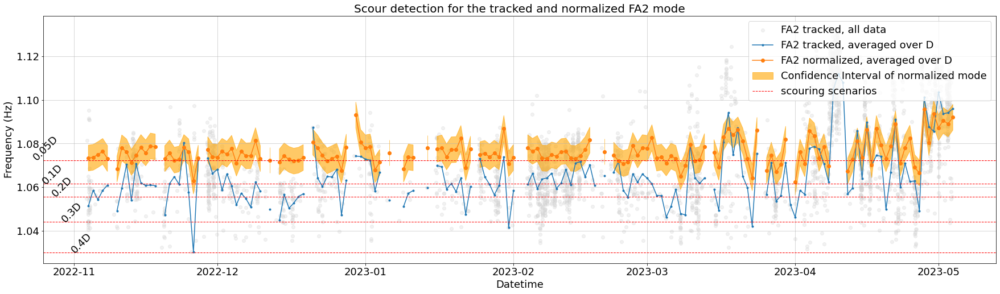

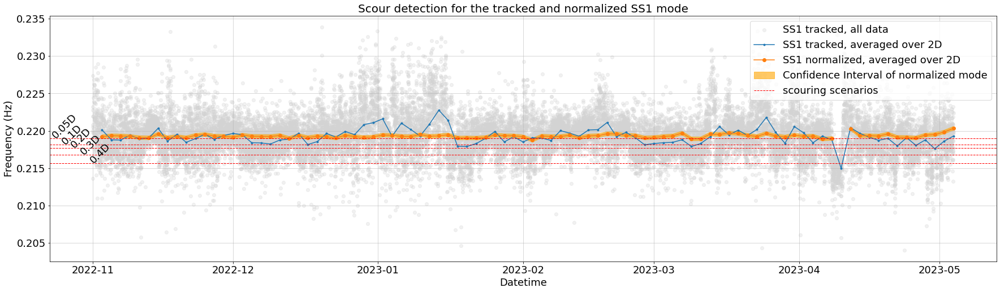

...

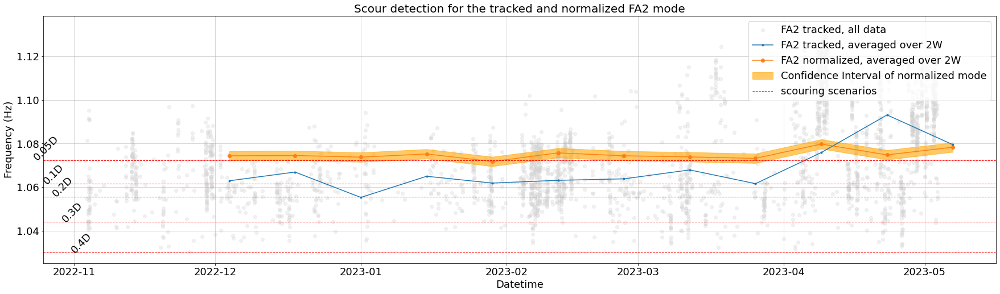

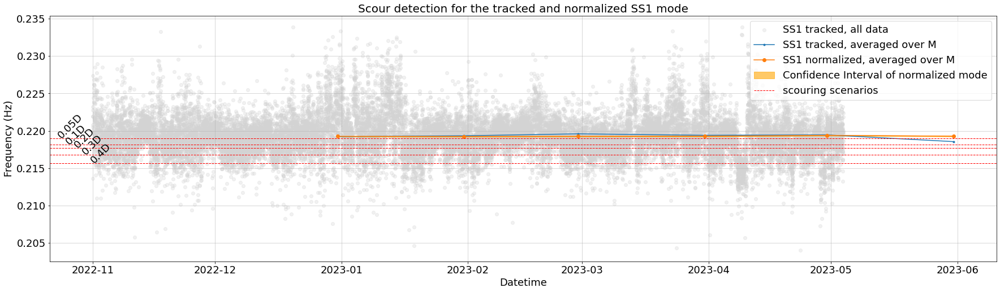

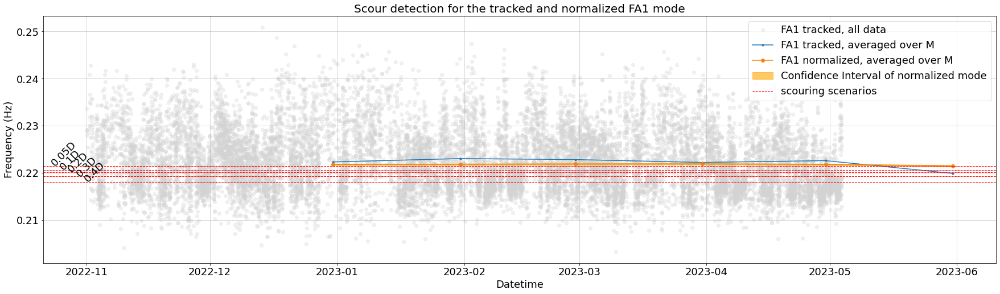

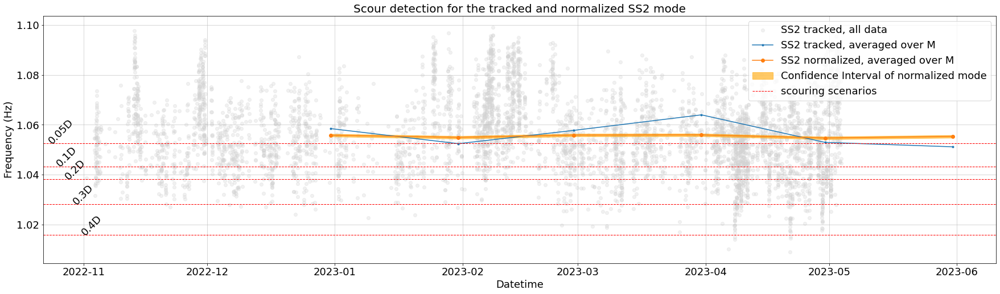

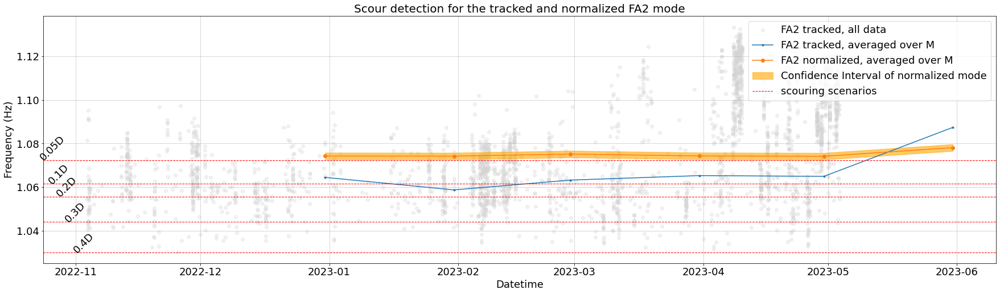

In [37]:
import warnings
warnings.filterwarnings('ignore')
font_size = 18
markers = ['.', 'o', 'v', '^', '<', '>', '1', '2', '3', '4', '8', 's', 'p', '*', 'h', 'H', '+', 'x', 'D', 'd', '|', '_']
timespans = ['D', '2D', 'W', '2W', 'M']
for timespan in timespans:
    for mode in ['SS1', 'FA1', 'SS2', 'FA2']:
        plt.figure(figsize=(30,8))
        plt.grid('--', linewidth=0.5)
        plt.title('Scour detection for the tracked and normalized ' + mode + ' mode', fontsize = 20)
        m = 0
        i = 0
        
        timely_tracked_frequencies = aggregate_time_series(tracked_frequencies, timespan)
        timely_normalized_frequencies = aggregate_time_series(normalized, timespan)
        plt.scatter(tracked_frequencies[mode].index, tracked_frequencies[mode], color='lightgrey', label = mode + ' tracked, all data', alpha=0.3)
        plt.plot(timely_tracked_frequencies[mode], label = mode + ' tracked, averaged over ' + timespan, marker = markers[m])
        m += 1
        var_training = timely_normalized_frequencies[mode].loc[:end_training].var(ddof=1)
        std = z*np.sqrt(var_training/(len(normalized[mode])/len(timely_normalized_frequencies[mode]))) # std average  
        std = timely_normalized_frequencies[mode].std()
        plt.plot(timely_normalized_frequencies[mode], label = mode + ' normalized, averaged over ' + timespan, marker = markers[m])
        plt.fill_between(timely_normalized_frequencies[mode].index, timely_normalized_frequencies[mode] - std, timely_normalized_frequencies[mode] + std, color='orange', alpha=0.6, label='Confidence Interval of normalized mode')
        label = 'scouring scenarios'
        for value in simulation_shifts['parked_scour'][mode].values[:5]:
            plt.axhline(normalized[mode].mean() - normalized[mode].mean()*value/100, color='red', linestyle='--', linewidth=1.0, label = label)
            plt.text(normalized[mode].index[0] - datetime.timedelta(days=9-2*i), normalized[mode].mean() - normalized[mode].mean()*value/100, simulation_shifts['parked_scour'].index[i], fontsize=font_size, rotation = 45)
            i += 1
            label =None
        plt.xticks(fontsize=font_size)
        plt.yticks(fontsize=font_size)
        plt.xlabel('Datetime', fontsize=font_size)
        plt.ylabel('Frequency (Hz)', fontsize=font_size)
        plt.legend(fontsize=font_size, loc='upper right')
        plt.show()

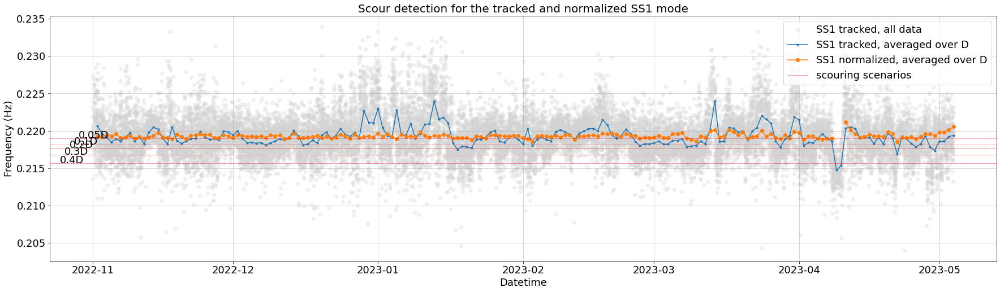

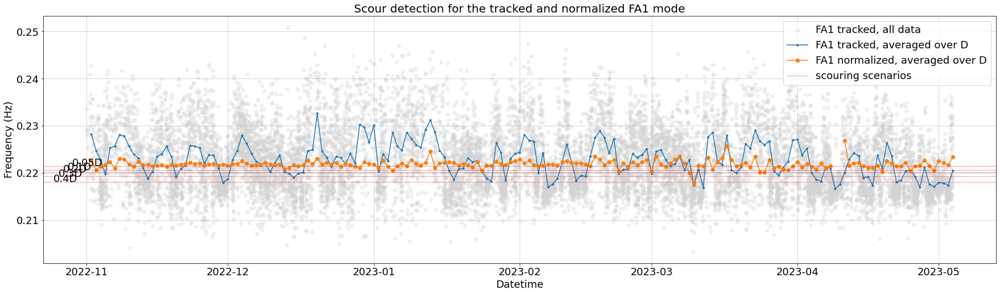

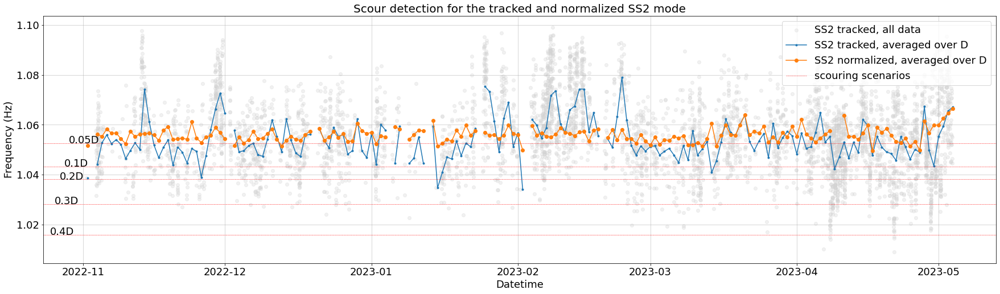

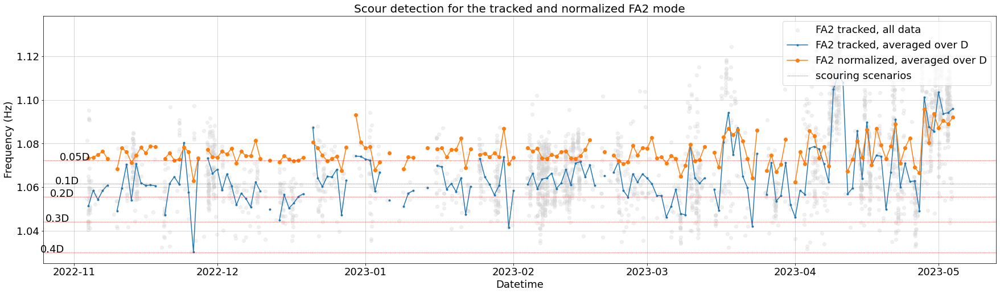

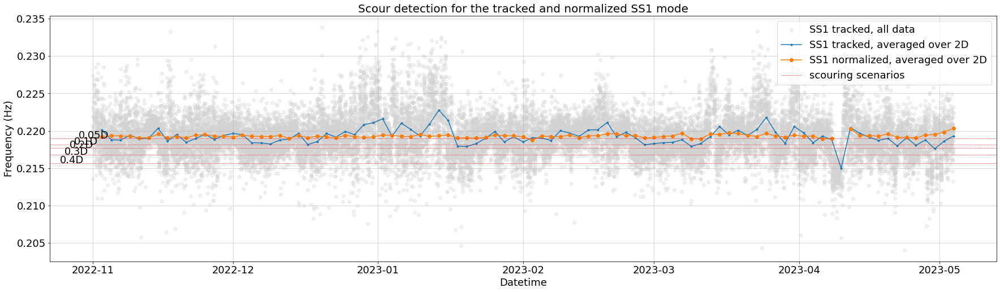

...

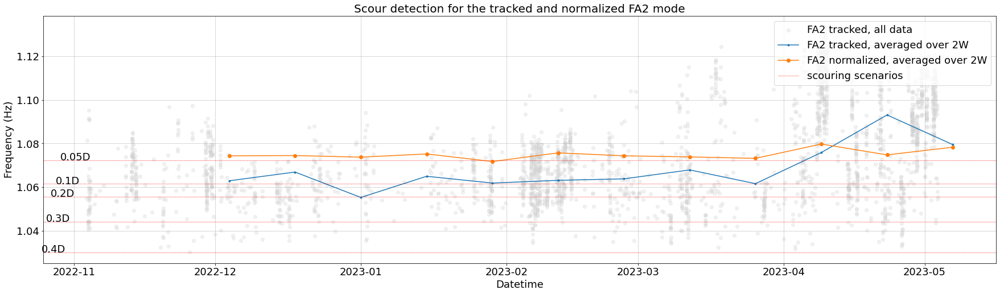

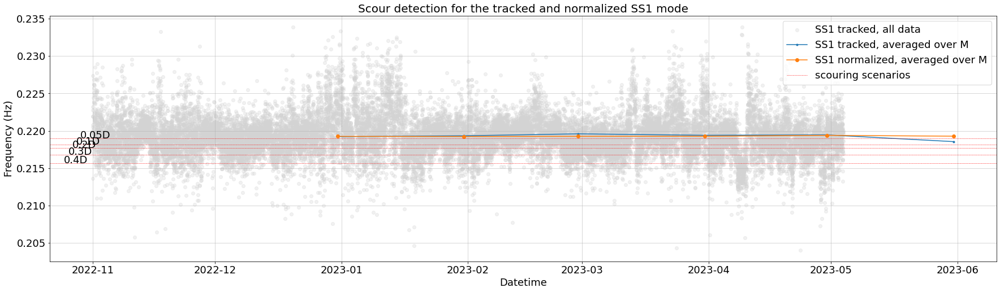

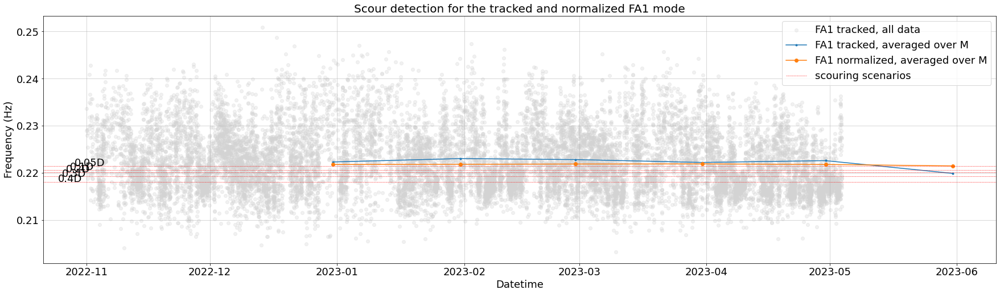

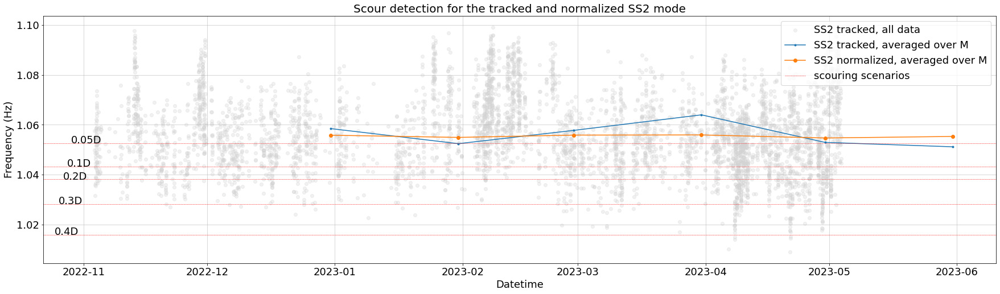

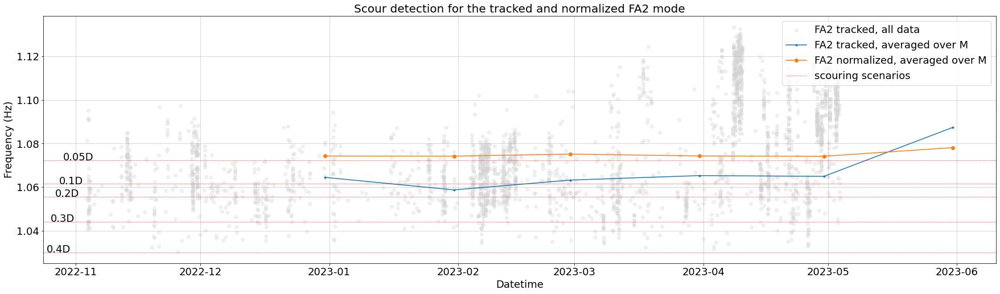

In [ ]:
import warnings
warnings.filterwarnings('ignore')
font_size = 18
markers = ['.', 'o', 'v', '^', '<', '>', '1', '2', '3', '4', '8', 's', 'p', '*', 'h', 'H', '+', 'x', 'D', 'd', '|', '_']
timespans = ['D', '2D', 'W', '2W', 'M']
for timespan in timespans:
    for mode in ['SS1', 'FA1', 'SS2', 'FA2']:
        plt.figure(figsize=(30,8))
        plt.grid('--', linewidth=0.5)
        plt.title('Scour detection for the tracked and normalized ' + mode + ' mode', fontsize = 20)
        m = 0
        i = 0
        
        timely_tracked_frequencies = aggregate_time_series(tracked_frequencies, timespan)
        timely_normalized_frequencies = aggregate_time_series(normalized, timespan)
        plt.scatter(tracked_frequencies[mode].index, tracked_frequencies[mode], color='lightgrey', label = mode + ' tracked, all data', alpha=0.3)
        plt.plot(timely_tracked_frequencies[mode], label = mode + ' tracked, averaged over ' + timespan, marker = markers[m])
        m += 1
        plt.plot(timely_normalized_frequencies[mode], label = mode + ' normalized, averaged over ' + timespan, marker = markers[m])
        label = 'scouring scenarios'
        for value in simulation_shifts['parked_scour'][mode].values[:5]:
            plt.axhline(normalized[mode].mean() - normalized[mode].mean()*value/100, color='red', linestyle='--', linewidth=0.5, label = label)
            plt.text(normalized[mode].index[0] - datetime.timedelta(days=3+i), normalized[mode].mean() - normalized[mode].mean()*value/100, simulation_shifts['parked_scour'].index[i], fontsize=font_size)
            i += 1
            label =None
        plt.xticks(fontsize=font_size)
        plt.yticks(fontsize=font_size)
        plt.xlabel('Datetime', fontsize=font_size)
        plt.ylabel('Frequency (Hz)', fontsize=font_size)
        plt.legend(fontsize=font_size, loc='upper right')
        plt.show()

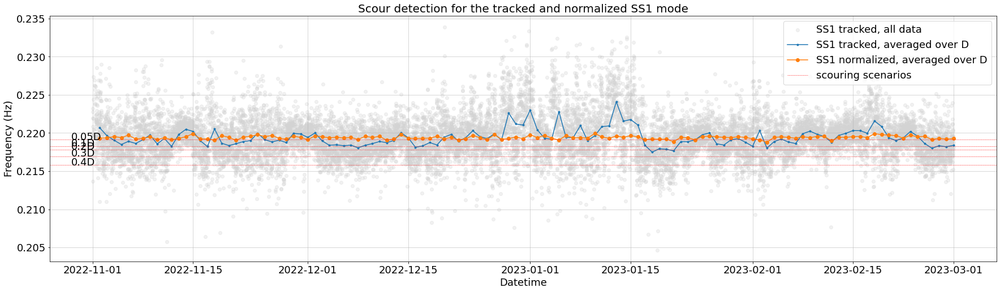

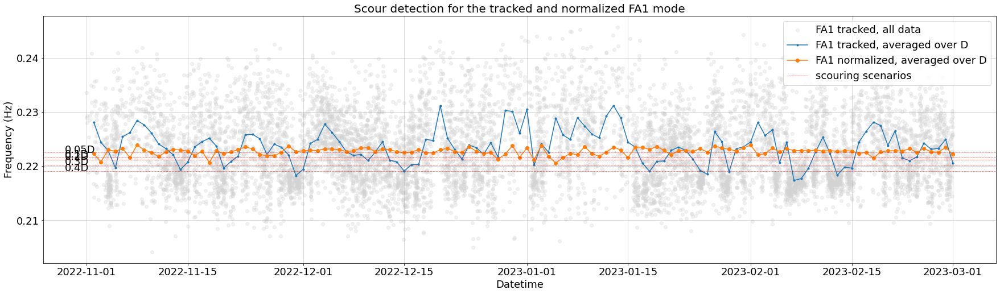

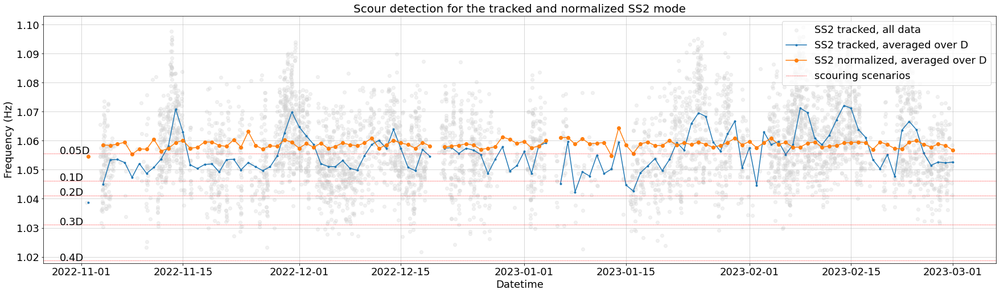

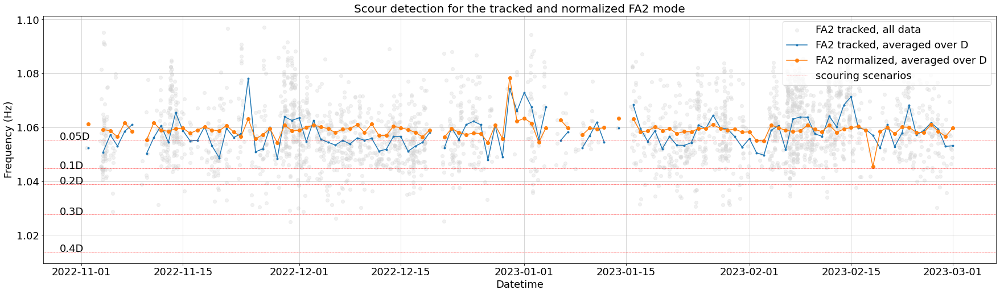

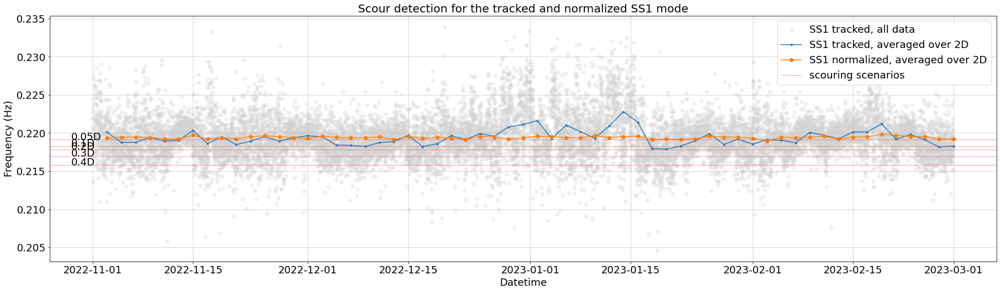

...

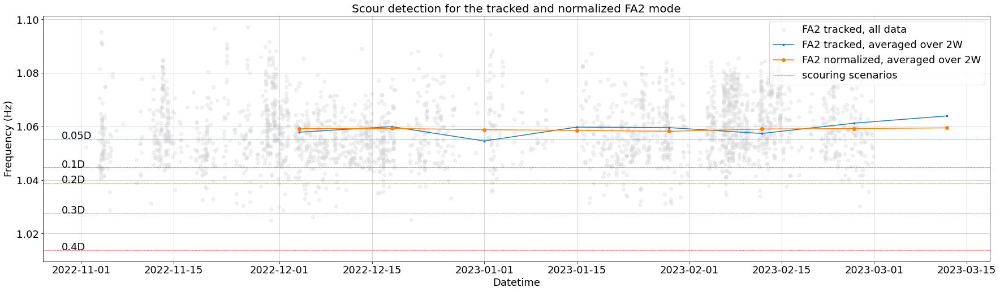

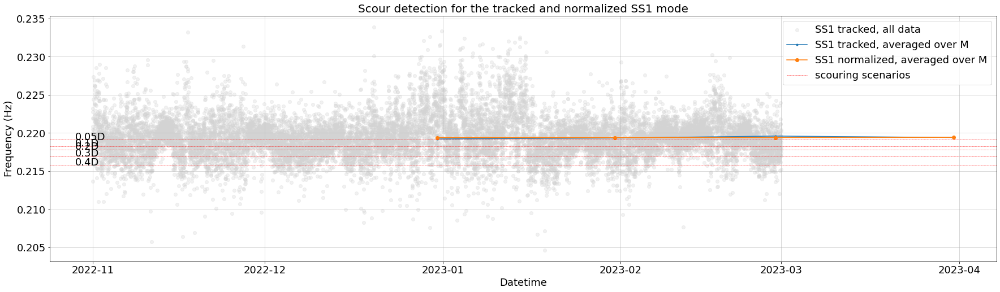

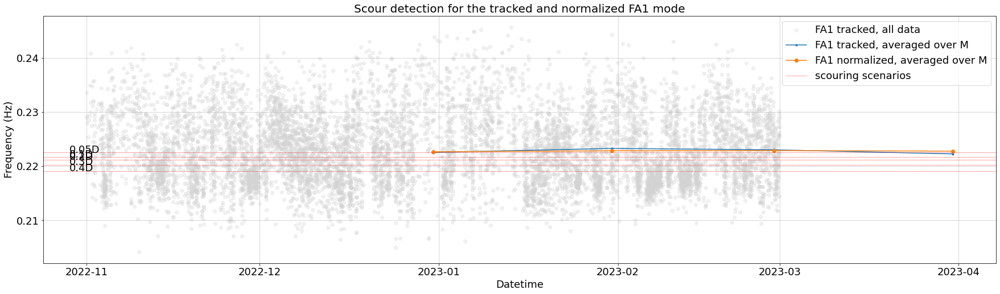

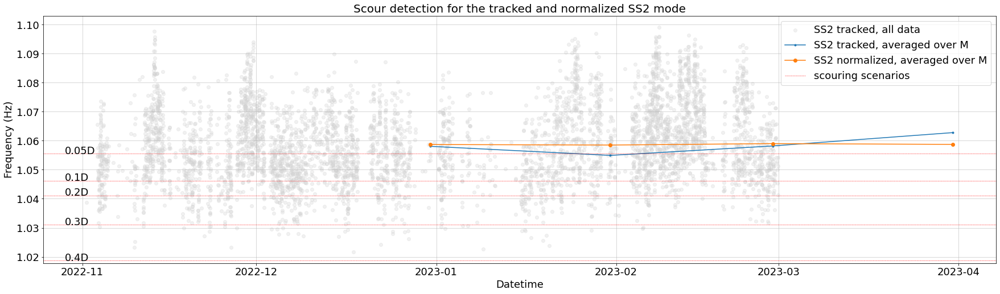

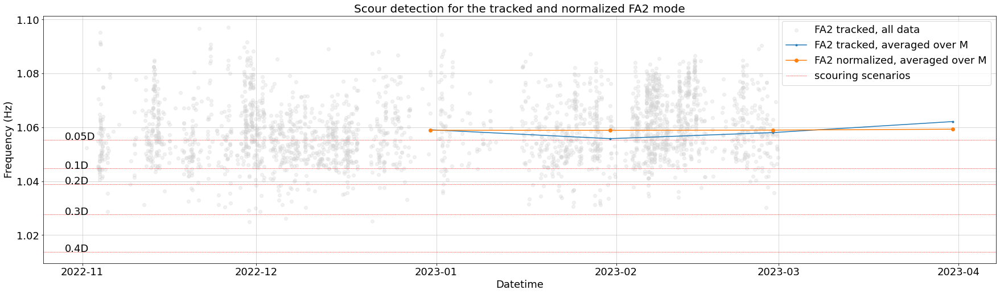

In [ ]:
import warnings
warnings.filterwarnings('ignore')
font_size = 18
markers = ['.', 'o', 'v', '^', '<', '>', '1', '2', '3', '4', '8', 's', 'p', '*', 'h', 'H', '+', 'x', 'D', 'd', '|', '_']
timespans = ['D', '2D', 'W', '2W', 'M']
for timespan in timespans:
    for mode in ['SS1', 'FA1', 'SS2', 'FA2']:
        plt.figure(figsize=(30,8))
        plt.grid('--', linewidth=0.5)
        plt.title('Scour detection for the tracked and normalized ' + mode + ' mode', fontsize = 20)
        m = 0
        i = 0
        
        timely_tracked_frequencies = aggregate_time_series(tracked_frequencies, timespan)
        timely_normalized_frequencies = aggregate_time_series(normalized, timespan)
        plt.scatter(tracked_frequencies[mode].index, tracked_frequencies[mode], color='lightgrey', label = mode + ' tracked, all data', alpha=0.3)
        plt.plot(timely_tracked_frequencies[mode], label = mode + ' tracked, averaged over ' + timespan, marker = markers[m])
        m += 1
        plt.plot(timely_normalized_frequencies[mode], label = mode + ' normalized, averaged over ' + timespan, marker = markers[m])
        label = 'scouring scenarios'
        for value in simulation_shifts['parked_scour'][mode].values[:5]:
            plt.axhline(normalized[mode].mean() - normalized[mode].mean()*value/100, color='red', linestyle='--', linewidth=0.5, label = label)
            plt.text(normalized[mode].index[0] - datetime.timedelta(days=3), normalized[mode].mean() - normalized[mode].mean()*value/100, simulation_shifts['parked_scour']['Unnamed: 0'].values[i], fontsize=font_size)
            i += 1
            label =None
        plt.xticks(fontsize=font_size)
        plt.yticks(fontsize=font_size)
        plt.xlabel('Datetime', fontsize=font_size)
        plt.ylabel('Frequency (Hz)', fontsize=font_size)
        plt.legend(fontsize=font_size, loc='upper right')
        plt.show()

0.21911474125954863
0.21828665542896894
0.21781916927219716
0.21691012531158613
0.21577803618351274


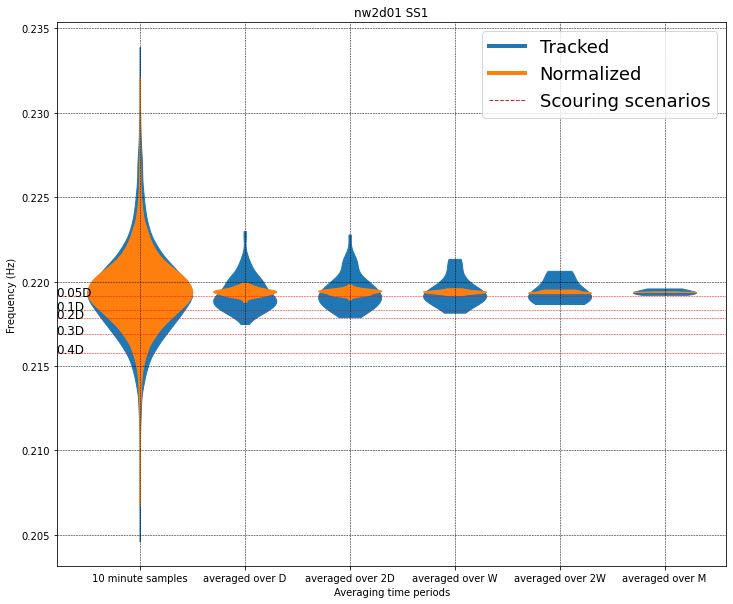

0.22249920667891196
0.22164660268524547
0.221165363759046
0.22022969842292953
0.21906469501319542


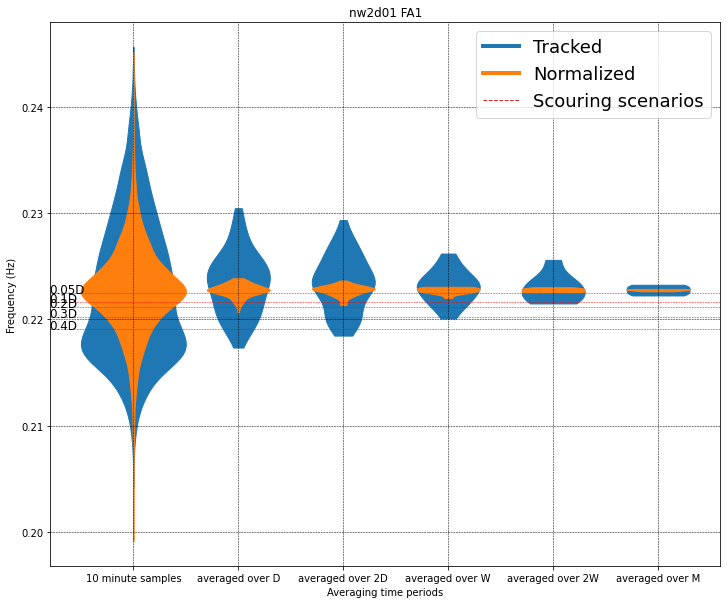

1.0554894873078704
1.0461860461869164
1.0410387575647881
1.0310361295622892
1.018687897227802


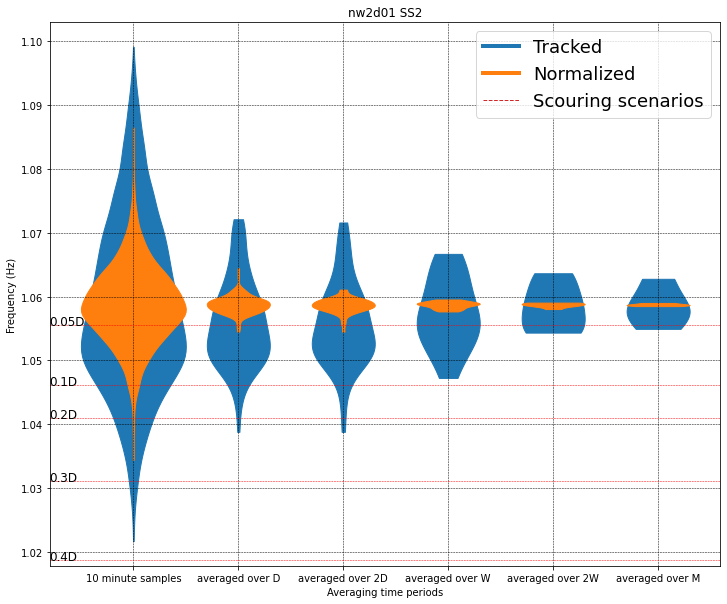

1.0553226815639867
1.044706050862608
1.0388666825301176
1.02757274466234
1.0137296016225184


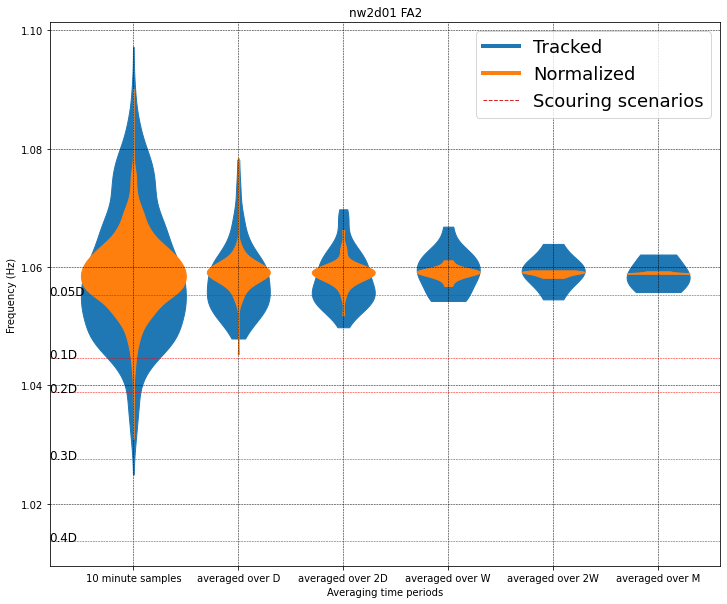

In [ ]:
from matplotlib.lines import Line2D
font_size = 18
label = 'scouring scenarios'
timespans = ['D', '2D', 'W', '2W', 'M']
for mode in ['SS1', 'FA1', 'SS2', 'FA2']:
    fig, ax = plt.subplots(figsize=(12, 10))
    i = 1
    x_keys = []
    vps = plt.violinplot(tracked_frequencies[mode].dropna(), positions=[i], widths=1.0, showextrema=False)
    for vp in vps['bodies']:
        vp.set_facecolor('tab:blue')
        vp.set_color('tab:blue')
        vp.set_alpha(1)
    vps = plt.violinplot(normalized[mode].dropna(), positions=[i], widths=1.0, showextrema=False)
    for vp in vps['bodies']:
        vp.set_facecolor('tab:orange')
        vp.set_color('tab:orange')
        vp.set_alpha(1)
    
    x_keys.append('10 minute samples')
    i += 1
    for timespan in timespans:
        timely_tracked_frequencies = aggregate_time_series(tracked_frequencies, timespan).dropna()
        timely_normalized_frequencies = aggregate_time_series(normalized, timespan).dropna()
        vps = plt.violinplot(timely_tracked_frequencies[mode], positions=[i], widths=0.6, showextrema=False)
        for vp in vps['bodies']:
            vp.set_facecolor('tab:blue')
            vp.set_color('tab:blue')
            vp.set_alpha(1)
        vps = plt.violinplot(timely_normalized_frequencies[mode], positions=[i], widths=0.6, showextrema=False)
        for vp in vps['bodies']:
            vp.set_facecolor('tab:orange')
            vp.set_color('tab:orange')
            vp.set_alpha(1)
        x_keys.append('averaged over ' + timespan)
        i += 1
    j = 0
    for value in simulation_shifts['parked_scour'][mode].values[:5]:
        shift = normalized[mode].mean() - normalized[mode].mean()*value/100
        print(shift)
        plt.axhline(shift, color='red', linestyle='--', linewidth=0.5, label = label)
        plt.text(
            0.2,
            shift,
            simulation_shifts['parked_scour']['Unnamed: 0'].values[j],
            fontsize=12
            )
        j += 1
    ax.set_xticks(range(1, len(x_keys) + 1))
    ax.set_xticklabels(x_keys, rotation=0)
    ax.set_title(location + ' ' + mode)
    ax.set_ylabel('Frequency (Hz)')
    ax.set_xlabel('Averaging time periods')
    ax.grid(True, color='k', linestyle='--', linewidth=0.5)
    plt.legend(
        [Line2D([0], [0], color='tab:blue', lw=4), Line2D([0], [0], color='tab:orange', lw=4), Line2D([0], [0], color='tab:red', lw=1, linestyle='--')],
        ['Tracked', 'Normalized', 'Scouring scenarios'],
        fontsize=font_size,
        loc='upper right')
    plt.show()